In [1]:
# # This Python 3 environment comes with many helpful analytics libraries installed
# # It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# # For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# # You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# # You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
!pip install -U -q segmentation-models
# print('m1')

In [3]:
from PIL import Image
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
os.environ["SM_FRAMEWORK"] = "tf.keras"

import segmentation_models as sm
import matplotlib.pyplot as plt 
import tensorflow_io as tfio
import tensorflow as tf


root = '../input/retinal-vessel-segmentation'
exts = ('jpg', 'JPG', 'png', 'PNG', 'tif', 'gif', 'ppm')

Segmentation Models: using `tf.keras` framework.


In [4]:
input_data = os.path.join(root, 'DRIVE/training/images')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)


target_data = os.path.join(root, 'DRIVE/training/1st_manual')
masks = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

print("Number of samples:", len(images), len(masks))
for input_path, target_path in zip(images[:10], masks[:10]):
    print(input_path[-31:], "|", target_path[-34:])

Number of samples: 20 20
training/images/21_training.tif | training/1st_manual/21_manual1.gif
training/images/22_training.tif | training/1st_manual/22_manual1.gif
training/images/23_training.tif | training/1st_manual/23_manual1.gif
training/images/24_training.tif | training/1st_manual/24_manual1.gif
training/images/25_training.tif | training/1st_manual/25_manual1.gif
training/images/26_training.tif | training/1st_manual/26_manual1.gif
training/images/27_training.tif | training/1st_manual/27_manual1.gif
training/images/28_training.tif | training/1st_manual/28_manual1.gif
training/images/29_training.tif | training/1st_manual/29_manual1.gif
training/images/30_training.tif | training/1st_manual/30_manual1.gif


In [5]:
IMAGE_SIZE = 512
BATCH_SIZE = 12

def read_files(image_path, mask=False):
    image = tf.io.read_file(image_path)
    if mask:
        image = tf.io.decode_gif(image) # out: (1, h, w, 3)
        image = tf.squeeze(image) # out: (h, w, 3)
        image = tf.image.rgb_to_grayscale(image) # out: (h, w, 1)
        image = tf.divide(image, 128)
        image.set_shape([None, None, 1])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = tf.cast(image, tf.int32)
    else:
        image = tfio.experimental.image.decode_tiff(image) # out: (h, w, 4)
        image = image[:,:,:3] # out: (h, w, 3)
        image.set_shape([None, None, 3])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = image / 255.
    return image

def load_data(image_list, mask_list):
    image = read_files(image_list)
    mask  = read_files(mask_list, mask=True)
    return image, mask

def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    return dataset

train_dataset = data_generator(images, masks)
train_dataset

<BatchDataset shapes: ((None, 512, 512, 3), (None, 512, 512, 1)), types: (tf.float32, tf.int32)>

In [6]:
def visualize(**images):
    """PLot images in one row."""
    n = len(images) 
    plt.figure(figsize=(20, 20))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image, cmap='gray')
    plt.show()

(12, 512, 512, 3) (12, 512, 512, 1)
0 1
[0 1]


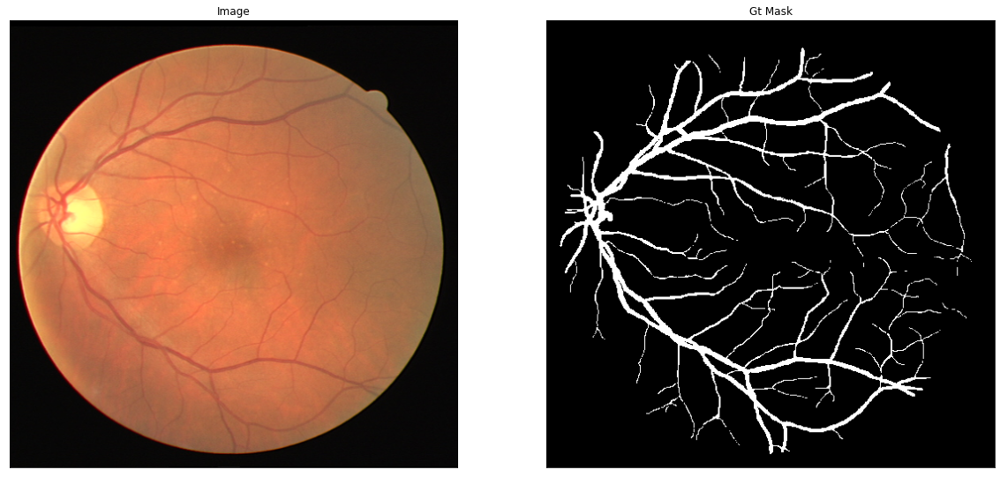

0 1
[0 1]


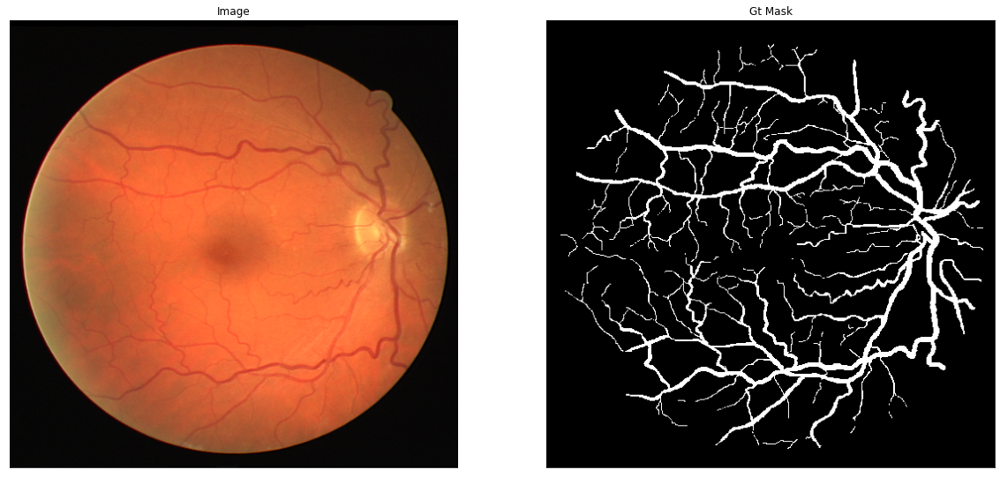

0 1
[0 1]


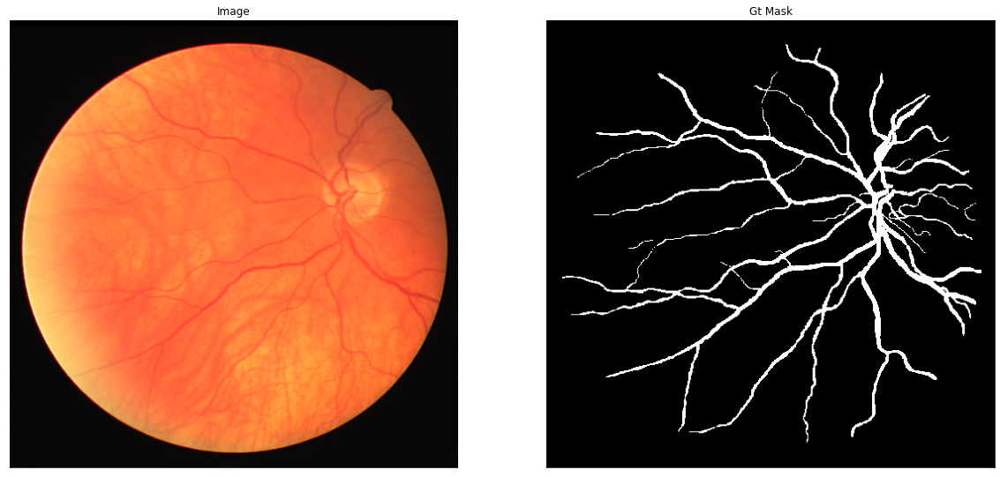

0 1
[0 1]


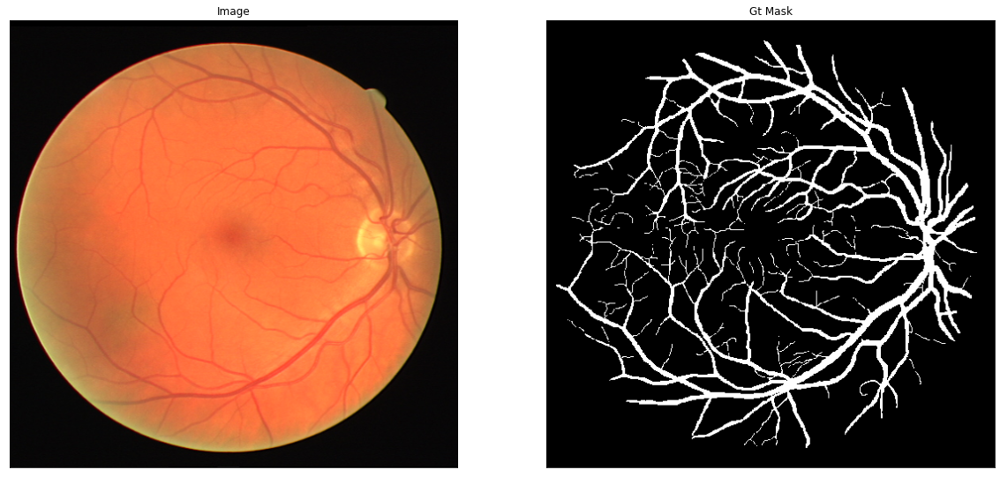

0 1
[0 1]


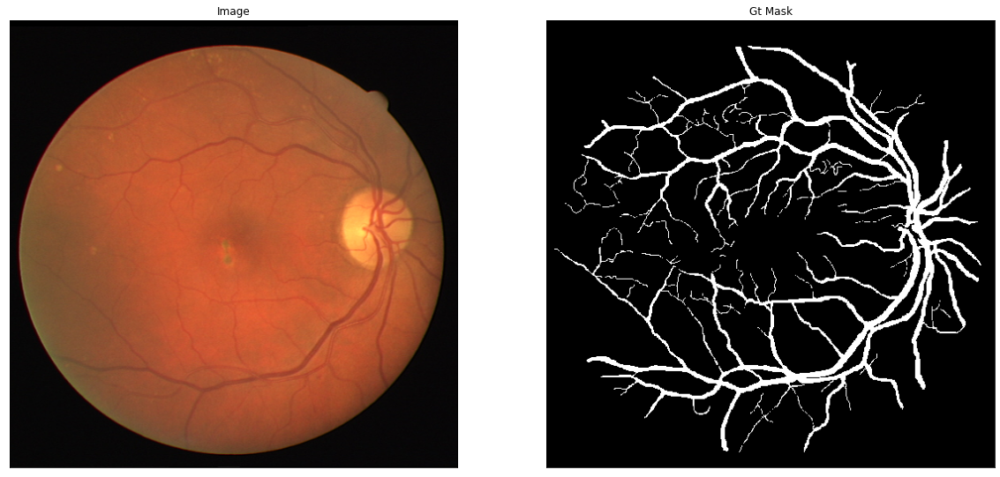

0 1
[0 1]


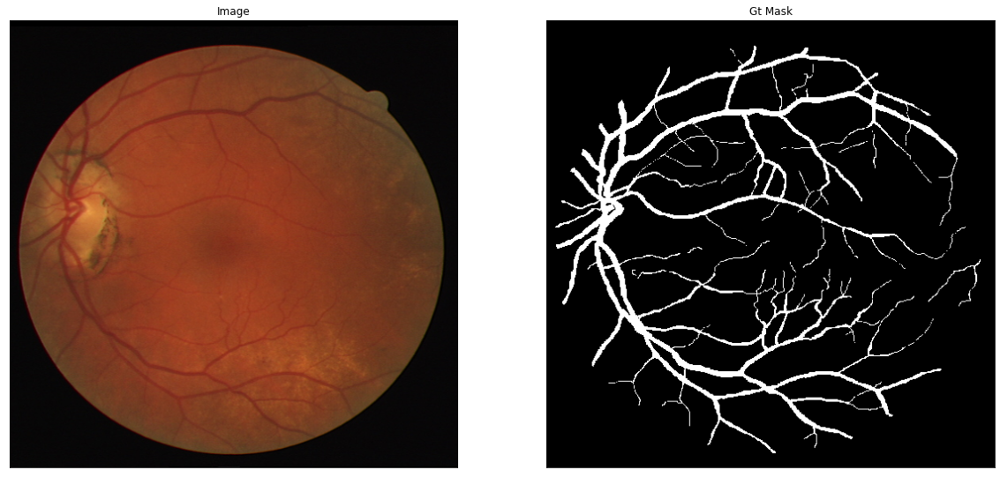

0 1
[0 1]


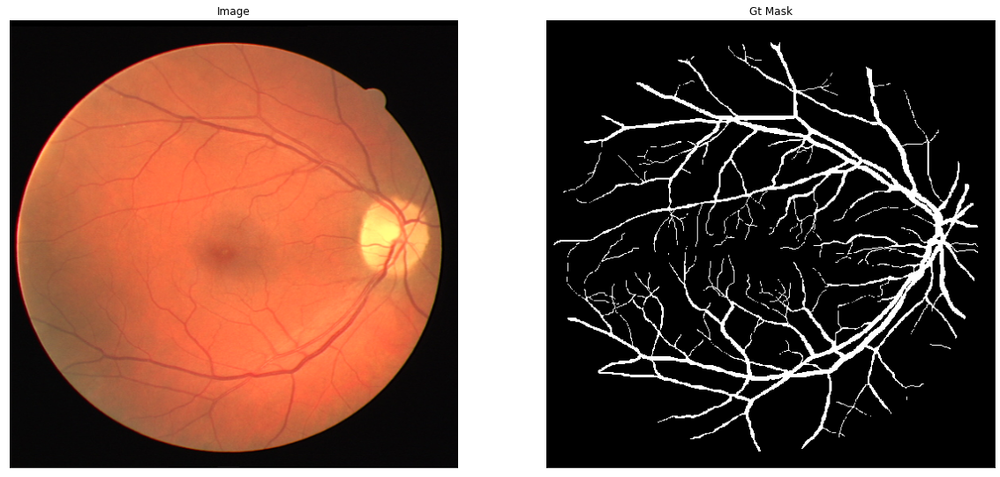

0 1
[0 1]


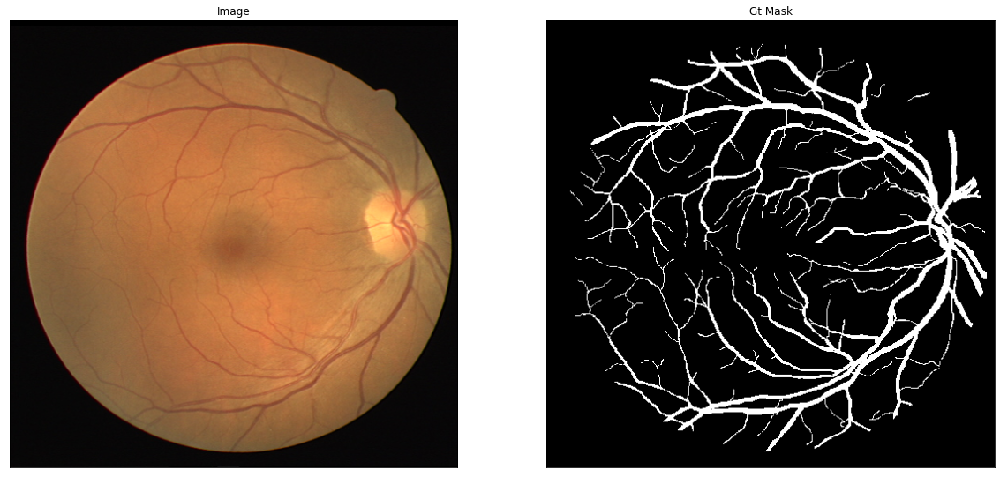

0 1
[0 1]


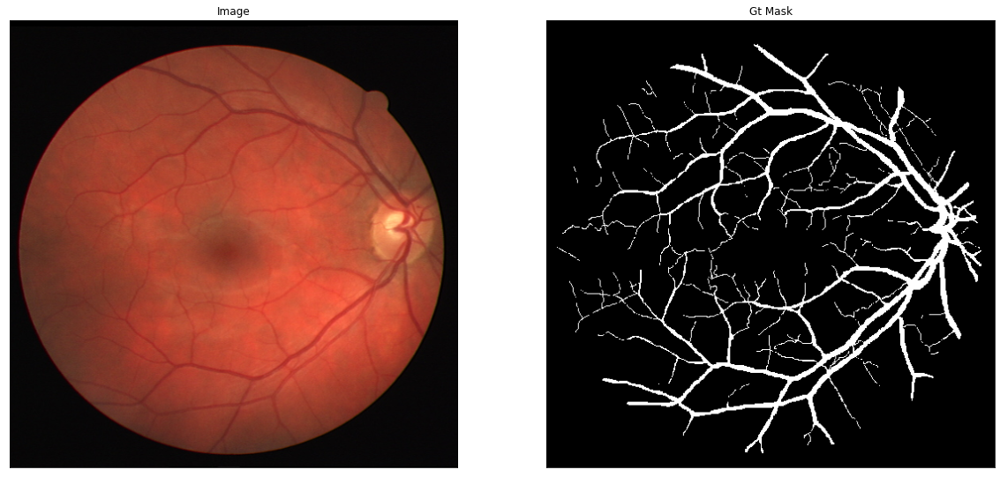

0 1
[0 1]


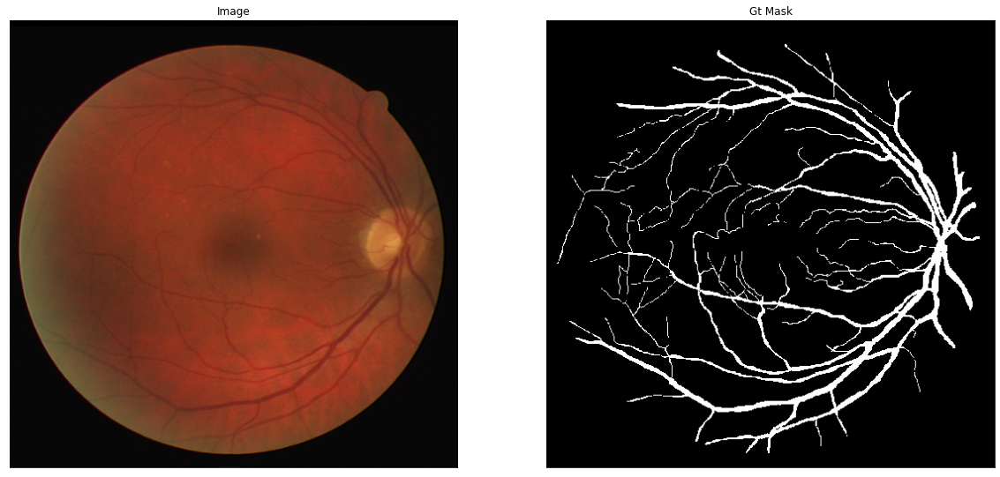

In [7]:
image, mask = next(iter(train_dataset.take(1))) 
print(image.shape, mask.shape)

for (img, msk) in zip(image[:10], mask[:10]):
    print(mask.numpy().min(), mask.numpy().max())
    print(np.unique(mask.numpy()))
    visualize(
        image=img.numpy(),
        gt_mask=msk.numpy(),
    )

In [8]:
from tensorflow import keras 

# Free up RAM in case the model definition cells were run multiple times
keras.backend.clear_session()
BACKBONE   = 'efficientnetb0'
n_classes  = 1 
activation = 'sigmoid' 
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
model.summary(line_length=110)

16818176/16804768 [==============================] - 0s 0us/step
Model: "model"
______________________________________________________________________________________________________________
Layer (type)                        Output Shape            Param #      Connected to                         
input_1 (InputLayer)                [(None, None, None, 3)] 0                                                 
______________________________________________________________________________________________________________
stem_conv (Conv2D)                  (None, None, None, 32)  864          input_1[0][0]                        
______________________________________________________________________________________________________________
stem_bn (BatchNormalization)        (None, None, None, 32)  128          stem_conv[0][0]                      
______________________________________________________________________________________________________________
stem_activation (Activation)    

In [9]:
class DisplayCallback(keras.callbacks.Callback):
    def __init__(self, dataset, epoch_interval=5):
        self.dataset = dataset
        self.epoch_interval = epoch_interval
    
    def display(self, display_list, extra_title=''):
        plt.figure(figsize=(15, 15))
        title = ['Input Image', 'True Mask', 'Predicted Mask']

        if len(display_list) > len(title):
            title.append(extra_title)

        for i in range(len(display_list)):
            plt.subplot(1, len(display_list), i+1)
            plt.title(title[i])
            plt.imshow(display_list[i], cmap='gray')
            plt.axis('off')
        plt.show()
        
    def create_mask(self, pred_mask):
        pred_mask = (pred_mask > 0.5).astype("int32")
        return pred_mask[0]
    
    def show_predictions(self, dataset, num=1):
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            self.display([image[0], mask[0], self.create_mask(pred_mask)])
        
    def on_epoch_end(self, epoch, logs=None):
        if epoch and epoch % self.epoch_interval == 0:
            self.show_predictions(self.dataset)
            print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

Epoch 1/400
2/2 [==============================] - 21s 3s/step - loss: 0.7633 - accuracy: 0.4672
Epoch 2/400
2/2 [==============================] - 1s 405ms/step - loss: 0.7362 - accuracy: 0.5524
Epoch 3/400
2/2 [==============================] - 1s 417ms/step - loss: 0.7145 - accuracy: 0.5958
Epoch 4/400
2/2 [==============================] - 1s 416ms/step - loss: 0.6949 - accuracy: 0.6301
Epoch 5/400
2/2 [==============================] - 1s 417ms/step - loss: 0.6757 - accuracy: 0.6609
Epoch 6/400
2/2 [==============================] - 1s 417ms/step - loss: 0.6567 - accuracy: 0.6880


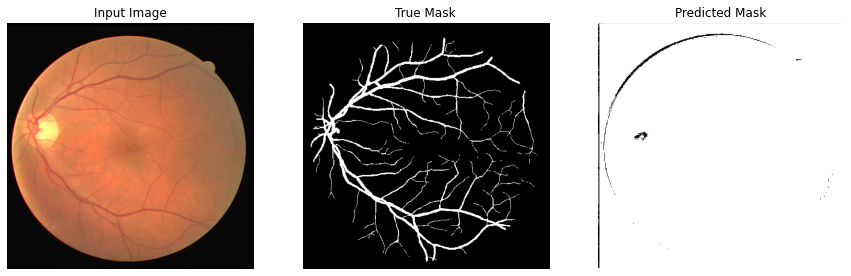


Sample Prediction after epoch 6

Epoch 7/400
2/2 [==============================] - 1s 415ms/step - loss: 0.6388 - accuracy: 0.7101
Epoch 8/400
2/2 [==============================] - 1s 419ms/step - loss: 0.6213 - accuracy: 0.7300
Epoch 9/400
2/2 [==============================] - 1s 417ms/step - loss: 0.6048 - accuracy: 0.7482
Epoch 10/400
2/2 [==============================] - 1s 417ms/step - loss: 0.5895 - accuracy: 0.7654
Epoch 11/400
2/2 [==============================] - 1s 417ms/step - loss: 0.5751 - accuracy: 0.7815


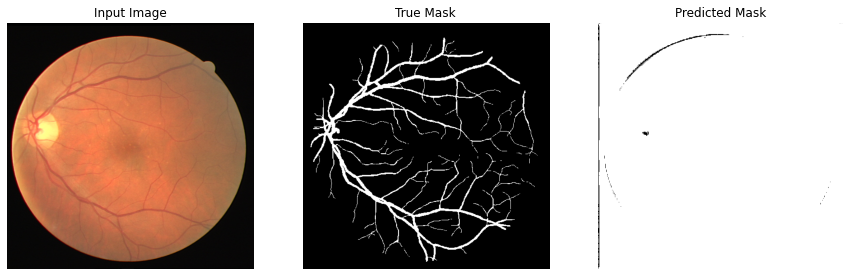


Sample Prediction after epoch 11

Epoch 12/400
2/2 [==============================] - 1s 416ms/step - loss: 0.5618 - accuracy: 0.7959
Epoch 13/400
2/2 [==============================] - 1s 417ms/step - loss: 0.5483 - accuracy: 0.8095
Epoch 14/400
2/2 [==============================] - 1s 417ms/step - loss: 0.5355 - accuracy: 0.8214
Epoch 15/400
2/2 [==============================] - 1s 403ms/step - loss: 0.5235 - accuracy: 0.8324
Epoch 16/400
2/2 [==============================] - 1s 418ms/step - loss: 0.5117 - accuracy: 0.8423


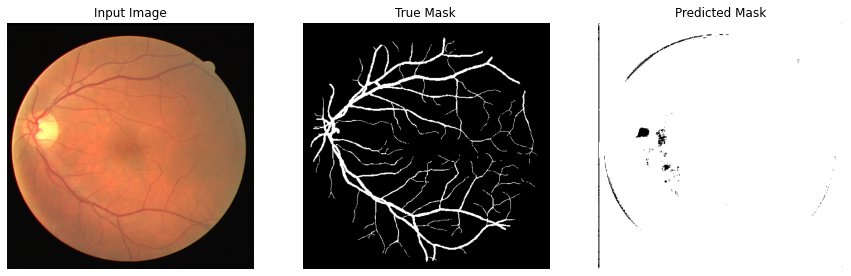


Sample Prediction after epoch 16

Epoch 17/400
2/2 [==============================] - 1s 415ms/step - loss: 0.5006 - accuracy: 0.8512
Epoch 18/400
2/2 [==============================] - 1s 418ms/step - loss: 0.4892 - accuracy: 0.8599
Epoch 19/400
2/2 [==============================] - 1s 417ms/step - loss: 0.4785 - accuracy: 0.8676
Epoch 20/400
2/2 [==============================] - 1s 419ms/step - loss: 0.4684 - accuracy: 0.8743
Epoch 21/400
2/2 [==============================] - 1s 415ms/step - loss: 0.4586 - accuracy: 0.8804


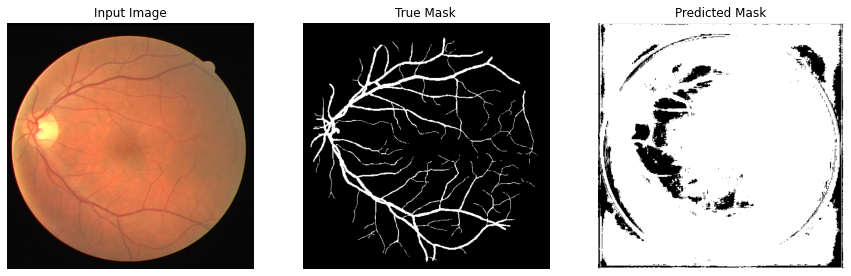


Sample Prediction after epoch 21

Epoch 22/400
2/2 [==============================] - 1s 417ms/step - loss: 0.4488 - accuracy: 0.8863
Epoch 23/400
2/2 [==============================] - 1s 416ms/step - loss: 0.4403 - accuracy: 0.8916
Epoch 24/400
2/2 [==============================] - 1s 404ms/step - loss: 0.4303 - accuracy: 0.8970
Epoch 25/400
2/2 [==============================] - 1s 415ms/step - loss: 0.4215 - accuracy: 0.9020
Epoch 26/400
2/2 [==============================] - 1s 416ms/step - loss: 0.4129 - accuracy: 0.9070


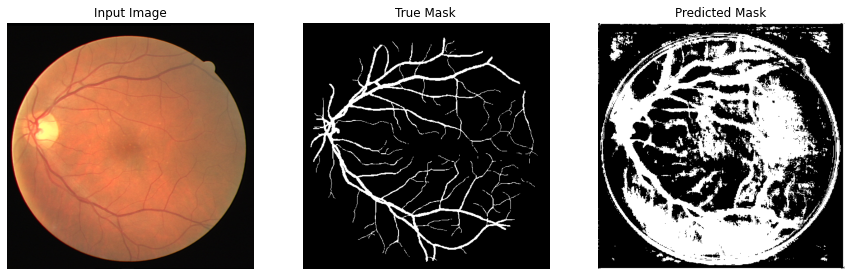


Sample Prediction after epoch 26

Epoch 27/400
2/2 [==============================] - 1s 417ms/step - loss: 0.4047 - accuracy: 0.9108
Epoch 28/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3967 - accuracy: 0.9147
Epoch 29/400
2/2 [==============================] - 1s 402ms/step - loss: 0.3893 - accuracy: 0.9180
Epoch 30/400
2/2 [==============================] - 1s 416ms/step - loss: 0.3809 - accuracy: 0.9219
Epoch 31/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3734 - accuracy: 0.9261


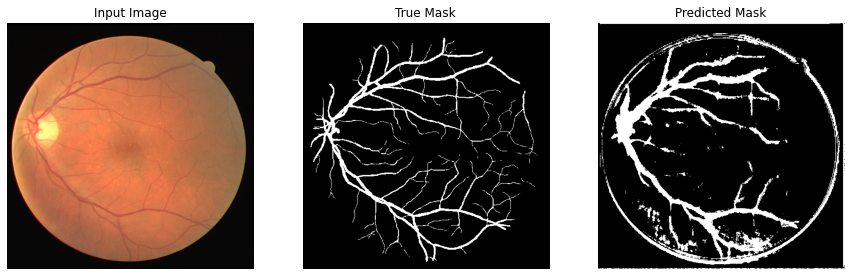


Sample Prediction after epoch 31

Epoch 32/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3667 - accuracy: 0.9286
Epoch 33/400
2/2 [==============================] - 1s 416ms/step - loss: 0.3590 - accuracy: 0.9317
Epoch 34/400
2/2 [==============================] - 1s 416ms/step - loss: 0.3524 - accuracy: 0.9347
Epoch 35/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3455 - accuracy: 0.9377
Epoch 36/400
2/2 [==============================] - 1s 416ms/step - loss: 0.3400 - accuracy: 0.9392


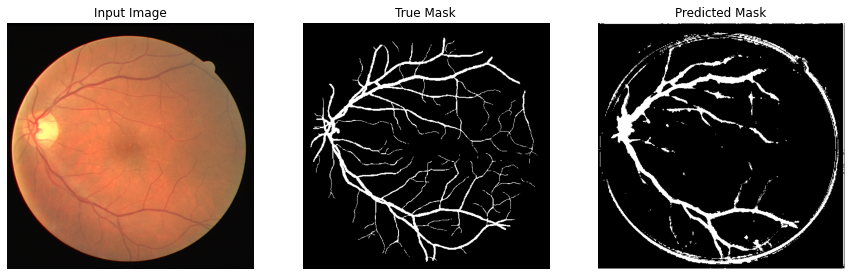


Sample Prediction after epoch 36

Epoch 37/400
2/2 [==============================] - 1s 407ms/step - loss: 0.3337 - accuracy: 0.9416
Epoch 38/400
2/2 [==============================] - 1s 401ms/step - loss: 0.3279 - accuracy: 0.9441
Epoch 39/400
2/2 [==============================] - 1s 416ms/step - loss: 0.3228 - accuracy: 0.9456
Epoch 40/400
2/2 [==============================] - 1s 417ms/step - loss: 0.3179 - accuracy: 0.9470
Epoch 41/400
2/2 [==============================] - 1s 404ms/step - loss: 0.3129 - accuracy: 0.9487


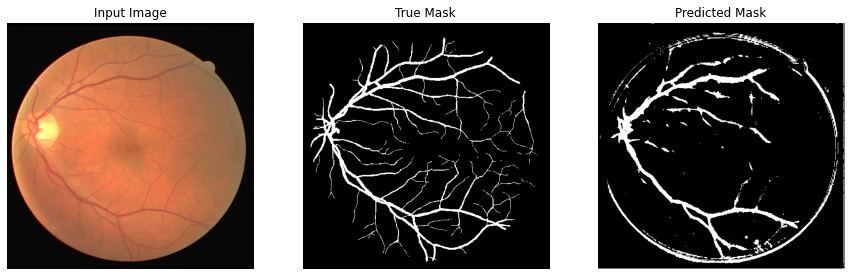


Sample Prediction after epoch 41

Epoch 42/400
2/2 [==============================] - 1s 416ms/step - loss: 0.3081 - accuracy: 0.9502
Epoch 43/400
2/2 [==============================] - 1s 424ms/step - loss: 0.3034 - accuracy: 0.9514
Epoch 44/400
2/2 [==============================] - 1s 419ms/step - loss: 0.2985 - accuracy: 0.9527
Epoch 45/400
2/2 [==============================] - 1s 403ms/step - loss: 0.2951 - accuracy: 0.9533
Epoch 46/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2904 - accuracy: 0.9546


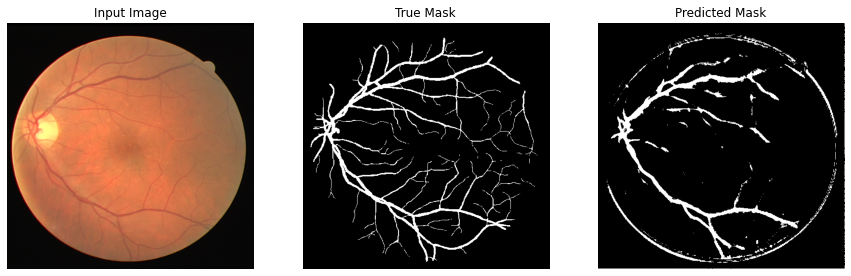


Sample Prediction after epoch 46

Epoch 47/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2863 - accuracy: 0.9554
Epoch 48/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2830 - accuracy: 0.9558
Epoch 49/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2798 - accuracy: 0.9561
Epoch 50/400
2/2 [==============================] - 1s 419ms/step - loss: 0.2759 - accuracy: 0.9572
Epoch 51/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2725 - accuracy: 0.9577


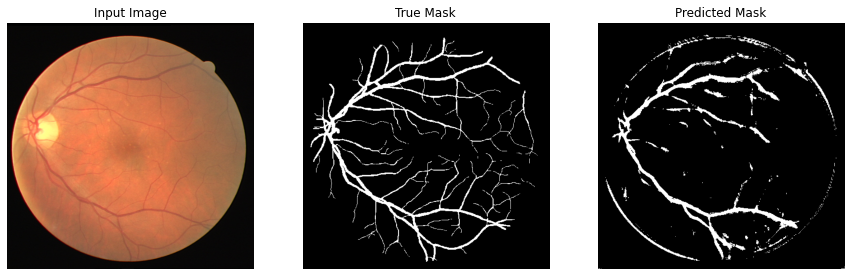


Sample Prediction after epoch 51

Epoch 52/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2697 - accuracy: 0.9579
Epoch 53/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2668 - accuracy: 0.9584
Epoch 54/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2635 - accuracy: 0.9589
Epoch 55/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2607 - accuracy: 0.9593
Epoch 56/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2578 - accuracy: 0.9598


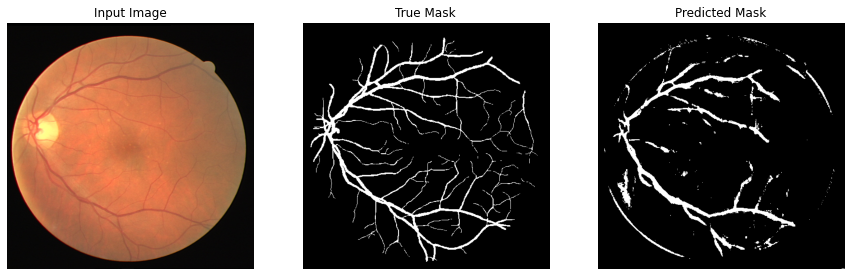


Sample Prediction after epoch 56

Epoch 57/400
2/2 [==============================] - 1s 405ms/step - loss: 0.2551 - accuracy: 0.9602
Epoch 58/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2523 - accuracy: 0.9605
Epoch 59/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2504 - accuracy: 0.9603
Epoch 60/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2471 - accuracy: 0.9615
Epoch 61/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2452 - accuracy: 0.9613


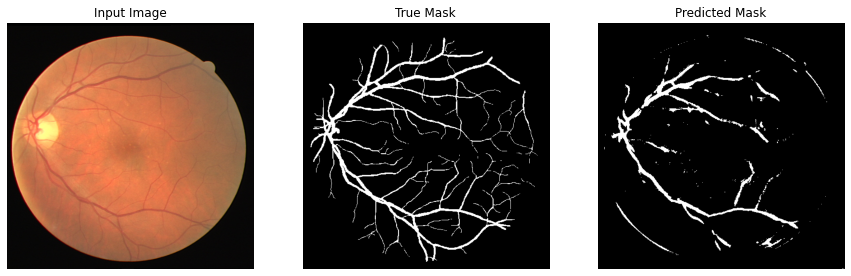


Sample Prediction after epoch 61

Epoch 62/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2429 - accuracy: 0.9615
Epoch 63/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2407 - accuracy: 0.9618
Epoch 64/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2384 - accuracy: 0.9621
Epoch 65/400
2/2 [==============================] - 1s 415ms/step - loss: 0.2359 - accuracy: 0.9623
Epoch 66/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2338 - accuracy: 0.9626


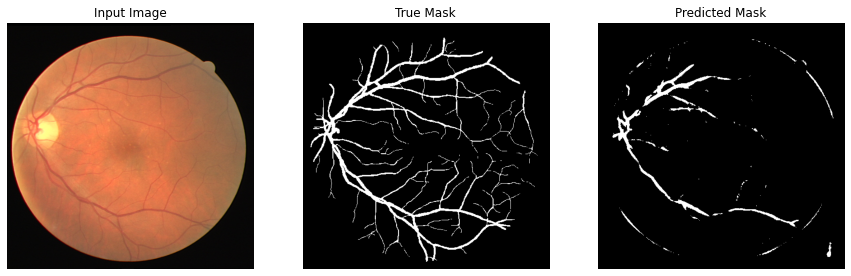


Sample Prediction after epoch 66

Epoch 67/400
2/2 [==============================] - 1s 404ms/step - loss: 0.2318 - accuracy: 0.9630
Epoch 68/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2300 - accuracy: 0.9630
Epoch 69/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2282 - accuracy: 0.9630
Epoch 70/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2263 - accuracy: 0.9635
Epoch 71/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2240 - accuracy: 0.9640


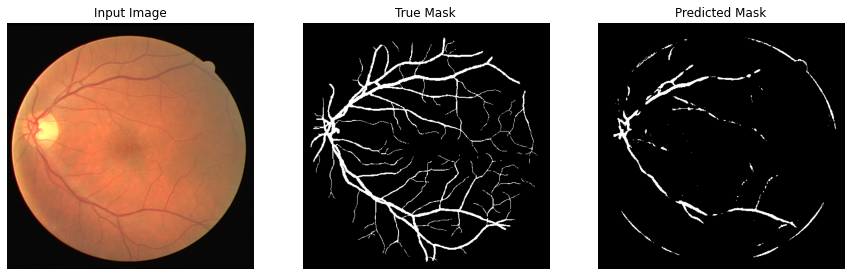


Sample Prediction after epoch 71

Epoch 72/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2228 - accuracy: 0.9639
Epoch 73/400
2/2 [==============================] - 1s 418ms/step - loss: 0.2204 - accuracy: 0.9641
Epoch 74/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2186 - accuracy: 0.9643
Epoch 75/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2167 - accuracy: 0.9649
Epoch 76/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2153 - accuracy: 0.9648


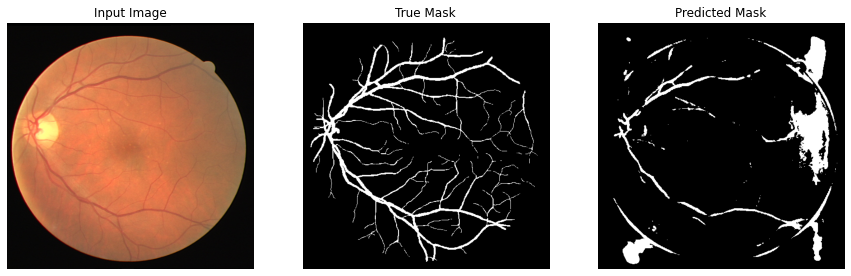


Sample Prediction after epoch 76

Epoch 77/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2137 - accuracy: 0.9648
Epoch 78/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2129 - accuracy: 0.9647
Epoch 79/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2102 - accuracy: 0.9654
Epoch 80/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2094 - accuracy: 0.9653
Epoch 81/400
2/2 [==============================] - 1s 415ms/step - loss: 0.2074 - accuracy: 0.9658


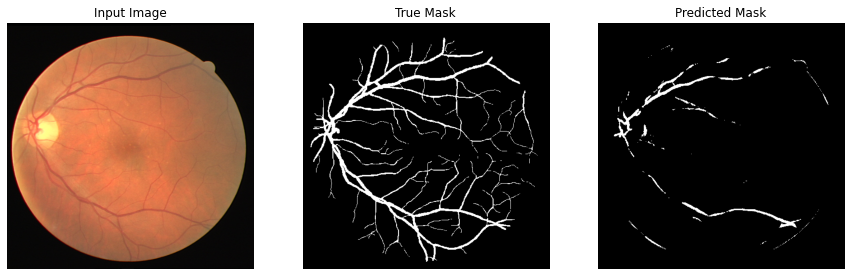


Sample Prediction after epoch 81

Epoch 82/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2056 - accuracy: 0.9659
Epoch 83/400
2/2 [==============================] - 1s 416ms/step - loss: 0.2042 - accuracy: 0.9660
Epoch 84/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2026 - accuracy: 0.9663
Epoch 85/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2017 - accuracy: 0.9663
Epoch 86/400
2/2 [==============================] - 1s 417ms/step - loss: 0.2000 - accuracy: 0.9665


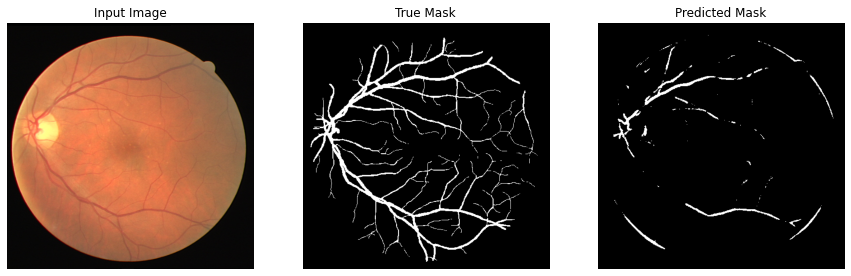


Sample Prediction after epoch 86

Epoch 87/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1991 - accuracy: 0.9664
Epoch 88/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1976 - accuracy: 0.9667
Epoch 89/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1960 - accuracy: 0.9670
Epoch 90/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1946 - accuracy: 0.9670
Epoch 91/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1933 - accuracy: 0.9672


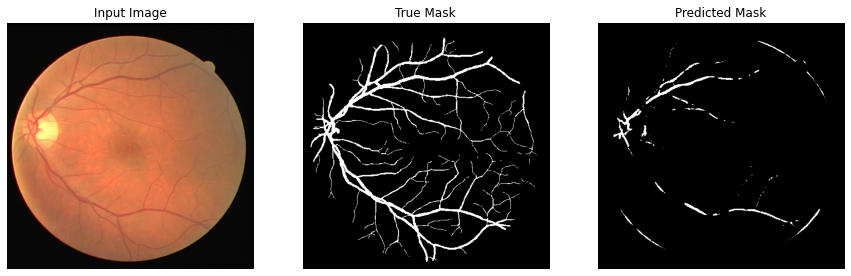


Sample Prediction after epoch 91

Epoch 92/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1926 - accuracy: 0.9672
Epoch 93/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1914 - accuracy: 0.9673
Epoch 94/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1898 - accuracy: 0.9676
Epoch 95/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1892 - accuracy: 0.9673
Epoch 96/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1875 - accuracy: 0.9678


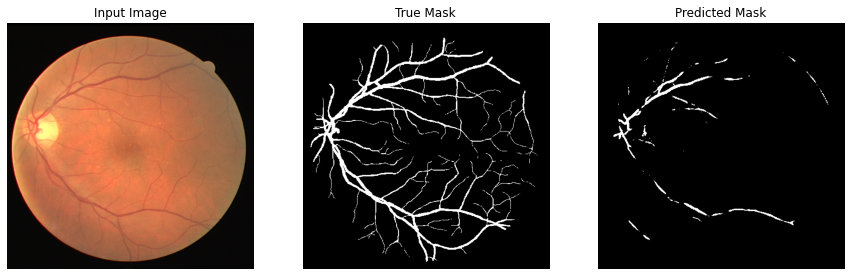


Sample Prediction after epoch 96

Epoch 97/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1862 - accuracy: 0.9681
Epoch 98/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1848 - accuracy: 0.9683
Epoch 99/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1839 - accuracy: 0.9682
Epoch 100/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1829 - accuracy: 0.9683
Epoch 101/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1820 - accuracy: 0.9684


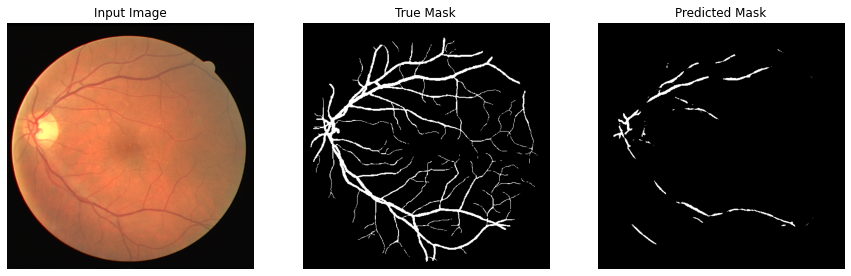


Sample Prediction after epoch 101

Epoch 102/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1803 - accuracy: 0.9688
Epoch 103/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1797 - accuracy: 0.9685
Epoch 104/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1786 - accuracy: 0.9689
Epoch 105/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1773 - accuracy: 0.9691
Epoch 106/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1762 - accuracy: 0.9690


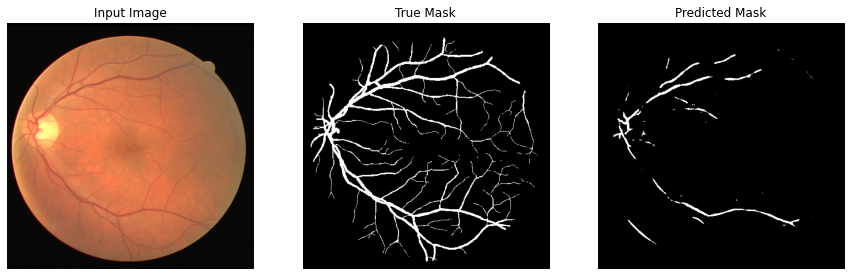


Sample Prediction after epoch 106

Epoch 107/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1750 - accuracy: 0.9694
Epoch 108/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1741 - accuracy: 0.9695
Epoch 109/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1736 - accuracy: 0.9692
Epoch 110/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1723 - accuracy: 0.9695
Epoch 111/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1709 - accuracy: 0.9699


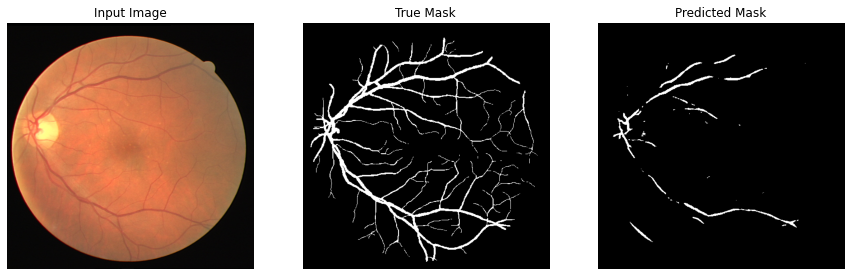


Sample Prediction after epoch 111

Epoch 112/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1708 - accuracy: 0.9696
Epoch 113/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1696 - accuracy: 0.9698
Epoch 114/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1683 - accuracy: 0.9700
Epoch 115/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1682 - accuracy: 0.9697
Epoch 116/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1667 - accuracy: 0.9702


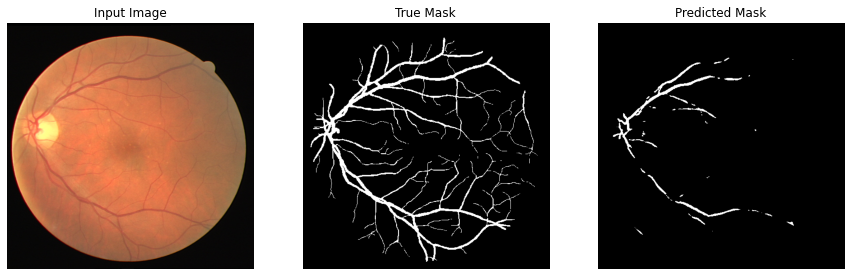


Sample Prediction after epoch 116

Epoch 117/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1659 - accuracy: 0.9702
Epoch 118/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1645 - accuracy: 0.9705
Epoch 119/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1643 - accuracy: 0.9702
Epoch 120/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1639 - accuracy: 0.9701
Epoch 121/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1620 - accuracy: 0.9708


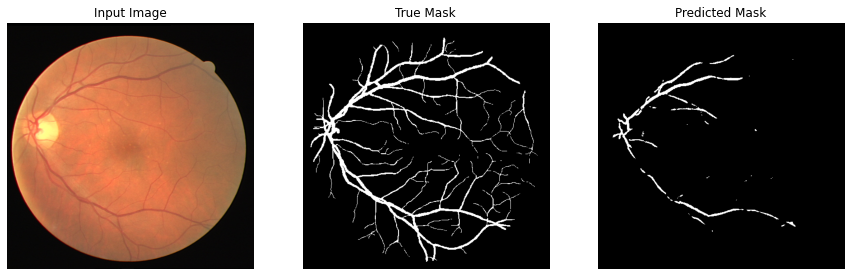


Sample Prediction after epoch 121

Epoch 122/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1618 - accuracy: 0.9704
Epoch 123/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1607 - accuracy: 0.9708
Epoch 124/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1597 - accuracy: 0.9708
Epoch 125/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1590 - accuracy: 0.9711
Epoch 126/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1581 - accuracy: 0.9711


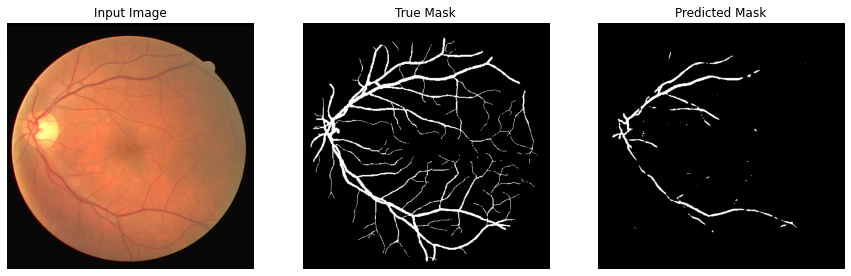


Sample Prediction after epoch 126

Epoch 127/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1572 - accuracy: 0.9712
Epoch 128/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1570 - accuracy: 0.9709
Epoch 129/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1560 - accuracy: 0.9713
Epoch 130/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1558 - accuracy: 0.9709
Epoch 131/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1544 - accuracy: 0.9713


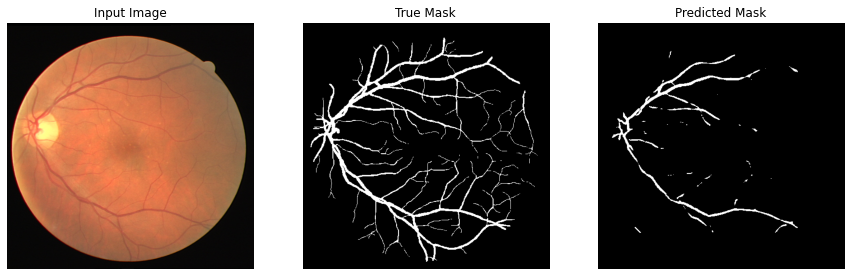


Sample Prediction after epoch 131

Epoch 132/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1538 - accuracy: 0.9713
Epoch 133/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1526 - accuracy: 0.9718
Epoch 134/400
2/2 [==============================] - 1s 402ms/step - loss: 0.1515 - accuracy: 0.9720
Epoch 135/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1509 - accuracy: 0.9719
Epoch 136/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1511 - accuracy: 0.9716


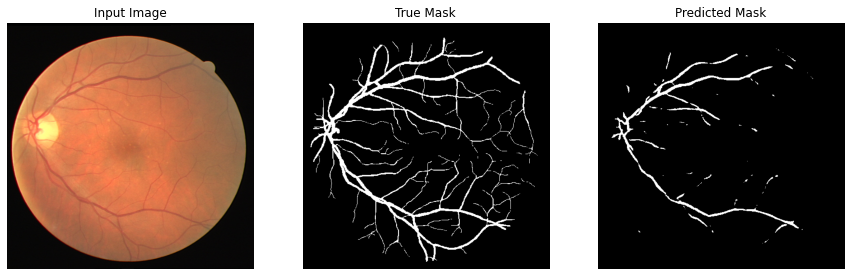


Sample Prediction after epoch 136

Epoch 137/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1493 - accuracy: 0.9723
Epoch 138/400
2/2 [==============================] - 1s 420ms/step - loss: 0.1487 - accuracy: 0.9722
Epoch 139/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1485 - accuracy: 0.9720
Epoch 140/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1475 - accuracy: 0.9723
Epoch 141/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1465 - accuracy: 0.9726


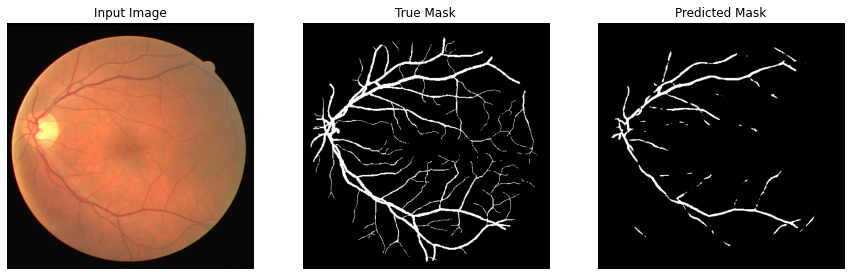


Sample Prediction after epoch 141

Epoch 142/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1456 - accuracy: 0.9727
Epoch 143/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1452 - accuracy: 0.9726
Epoch 144/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1452 - accuracy: 0.9724
Epoch 145/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1446 - accuracy: 0.9723
Epoch 146/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1435 - accuracy: 0.9727


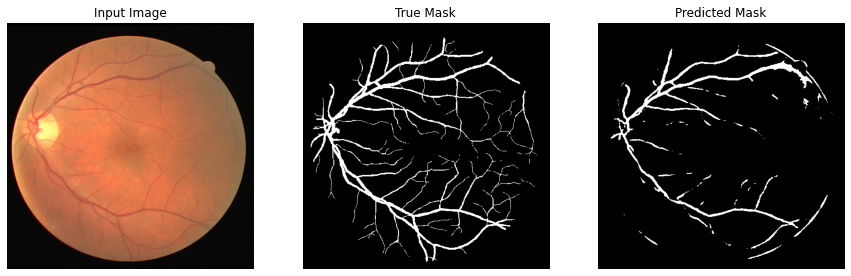


Sample Prediction after epoch 146

Epoch 147/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1423 - accuracy: 0.9731
Epoch 148/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1421 - accuracy: 0.9728
Epoch 149/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1408 - accuracy: 0.9734
Epoch 150/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1409 - accuracy: 0.9730
Epoch 151/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1397 - accuracy: 0.9734


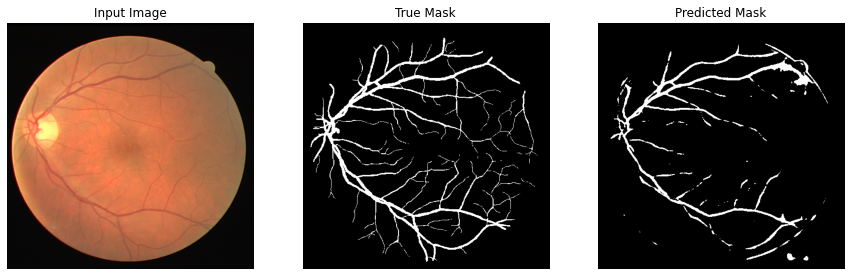


Sample Prediction after epoch 151

Epoch 152/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1393 - accuracy: 0.9733
Epoch 153/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1378 - accuracy: 0.9740
Epoch 154/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1379 - accuracy: 0.9735
Epoch 155/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1378 - accuracy: 0.9732
Epoch 156/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1377 - accuracy: 0.9731


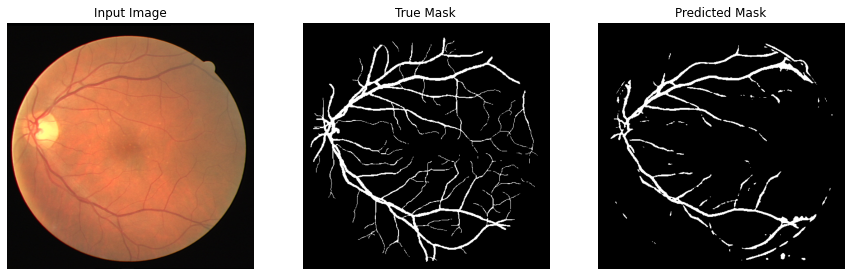


Sample Prediction after epoch 156

Epoch 157/400
2/2 [==============================] - 1s 401ms/step - loss: 0.1362 - accuracy: 0.9736
Epoch 158/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1352 - accuracy: 0.9739
Epoch 159/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1342 - accuracy: 0.9742
Epoch 160/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1340 - accuracy: 0.9740
Epoch 161/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1337 - accuracy: 0.9739


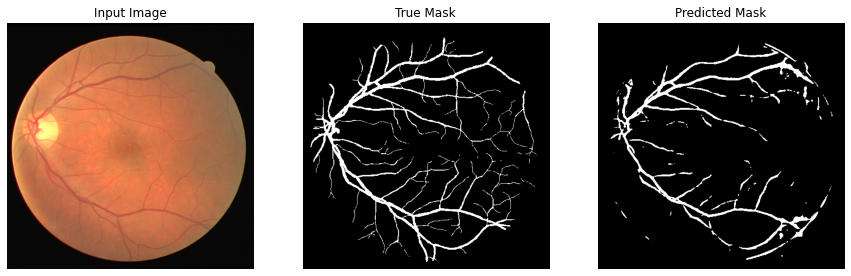


Sample Prediction after epoch 161

Epoch 162/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1339 - accuracy: 0.9735
Epoch 163/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1323 - accuracy: 0.9742
Epoch 164/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1316 - accuracy: 0.9743
Epoch 165/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1307 - accuracy: 0.9746
Epoch 166/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1306 - accuracy: 0.9746


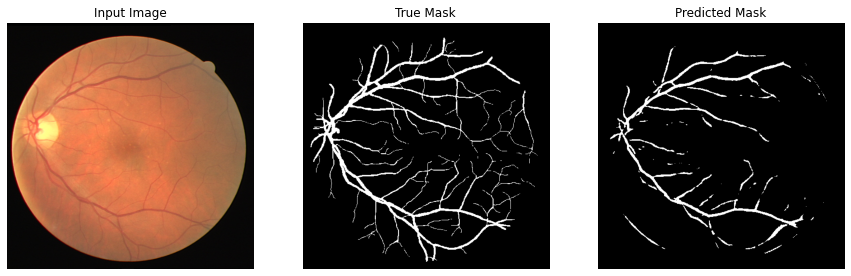


Sample Prediction after epoch 166

Epoch 167/400
2/2 [==============================] - 1s 420ms/step - loss: 0.1297 - accuracy: 0.9747
Epoch 168/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1291 - accuracy: 0.9748
Epoch 169/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1285 - accuracy: 0.9749
Epoch 170/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1286 - accuracy: 0.9745
Epoch 171/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1273 - accuracy: 0.9750


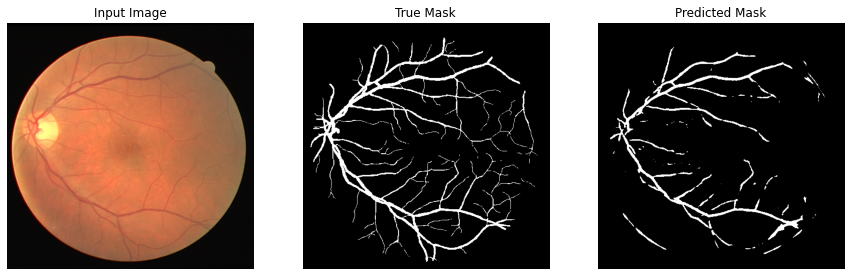


Sample Prediction after epoch 171

Epoch 172/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1270 - accuracy: 0.9749
Epoch 173/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1266 - accuracy: 0.9749
Epoch 174/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1258 - accuracy: 0.9751
Epoch 175/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1256 - accuracy: 0.9750
Epoch 176/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1245 - accuracy: 0.9754


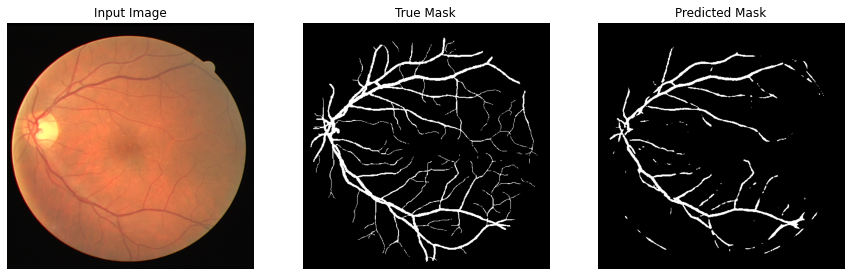


Sample Prediction after epoch 176

Epoch 177/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1244 - accuracy: 0.9752
Epoch 178/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1238 - accuracy: 0.9752
Epoch 179/400
2/2 [==============================] - 1s 420ms/step - loss: 0.1230 - accuracy: 0.9757
Epoch 180/400
2/2 [==============================] - 1s 420ms/step - loss: 0.1226 - accuracy: 0.9755
Epoch 181/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1218 - accuracy: 0.9758


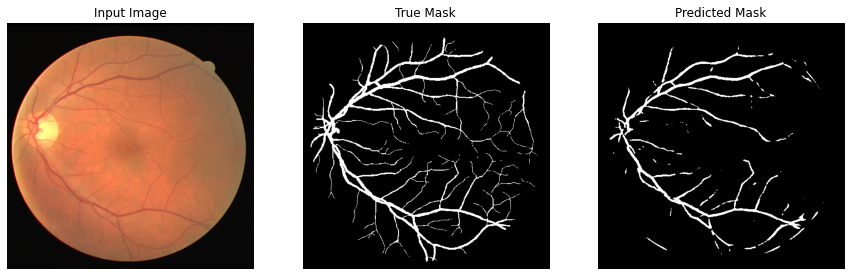


Sample Prediction after epoch 181

Epoch 182/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1218 - accuracy: 0.9755
Epoch 183/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1208 - accuracy: 0.9759
Epoch 184/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1202 - accuracy: 0.9759
Epoch 185/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1200 - accuracy: 0.9759
Epoch 186/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1194 - accuracy: 0.9761


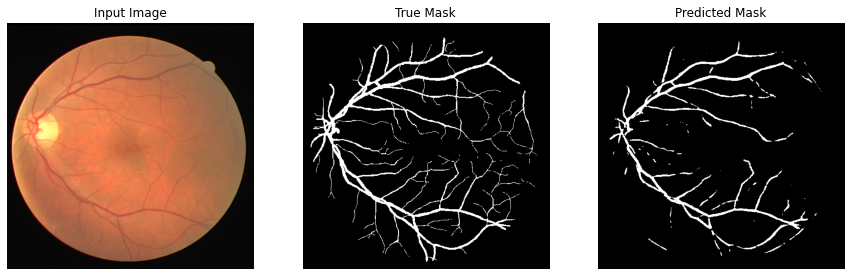


Sample Prediction after epoch 186

Epoch 187/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1191 - accuracy: 0.9760
Epoch 188/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1181 - accuracy: 0.9764
Epoch 189/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1184 - accuracy: 0.9759
Epoch 190/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1173 - accuracy: 0.9764
Epoch 191/400
2/2 [==============================] - 1s 405ms/step - loss: 0.1174 - accuracy: 0.9760


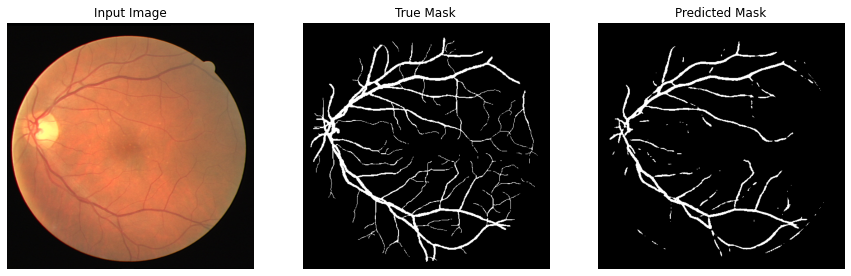


Sample Prediction after epoch 191

Epoch 192/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1163 - accuracy: 0.9765
Epoch 193/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1160 - accuracy: 0.9765
Epoch 194/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1164 - accuracy: 0.9759
Epoch 195/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1155 - accuracy: 0.9763
Epoch 196/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1149 - accuracy: 0.9765


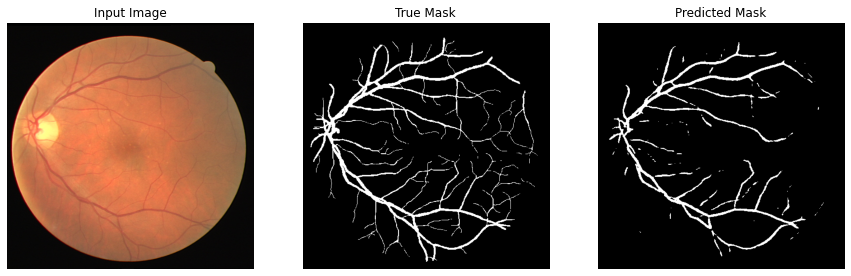


Sample Prediction after epoch 196

Epoch 197/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1138 - accuracy: 0.9769
Epoch 198/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1139 - accuracy: 0.9766
Epoch 199/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1127 - accuracy: 0.9771
Epoch 200/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1123 - accuracy: 0.9772
Epoch 201/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1126 - accuracy: 0.9767


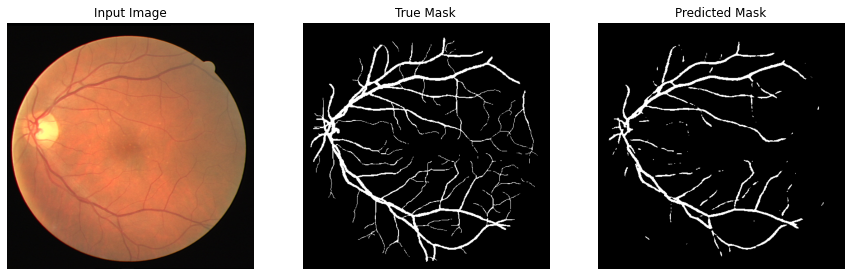


Sample Prediction after epoch 201

Epoch 202/400
2/2 [==============================] - 1s 404ms/step - loss: 0.1120 - accuracy: 0.9770
Epoch 203/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1108 - accuracy: 0.9775
Epoch 204/400
2/2 [==============================] - 1s 403ms/step - loss: 0.1112 - accuracy: 0.9770
Epoch 205/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1105 - accuracy: 0.9771
Epoch 206/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1096 - accuracy: 0.9776


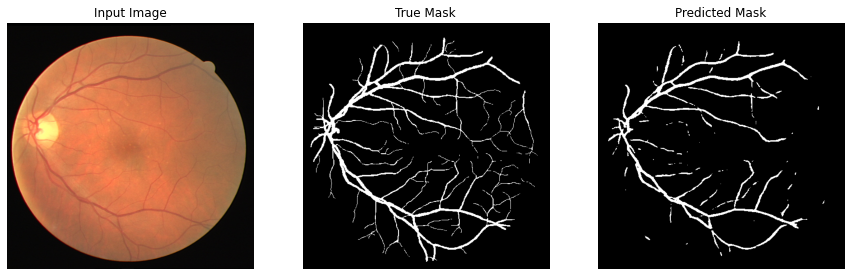


Sample Prediction after epoch 206

Epoch 207/400
2/2 [==============================] - 1s 414ms/step - loss: 0.1094 - accuracy: 0.9775
Epoch 208/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1085 - accuracy: 0.9778
Epoch 209/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1087 - accuracy: 0.9775
Epoch 210/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1080 - accuracy: 0.9778
Epoch 211/400
2/2 [==============================] - 1s 402ms/step - loss: 0.1082 - accuracy: 0.9774


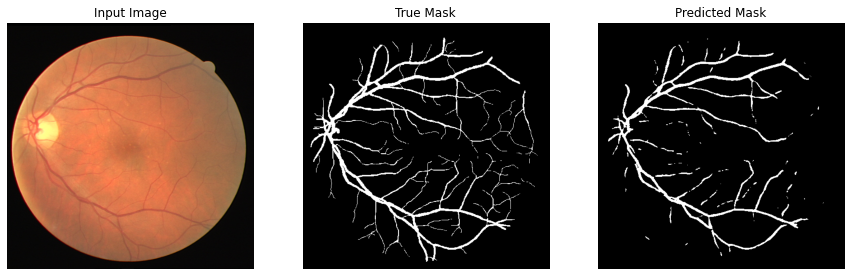


Sample Prediction after epoch 211

Epoch 212/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1070 - accuracy: 0.9779
Epoch 213/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1065 - accuracy: 0.9782
Epoch 214/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1063 - accuracy: 0.9780
Epoch 215/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1062 - accuracy: 0.9779
Epoch 216/400
2/2 [==============================] - 1s 419ms/step - loss: 0.1054 - accuracy: 0.9780


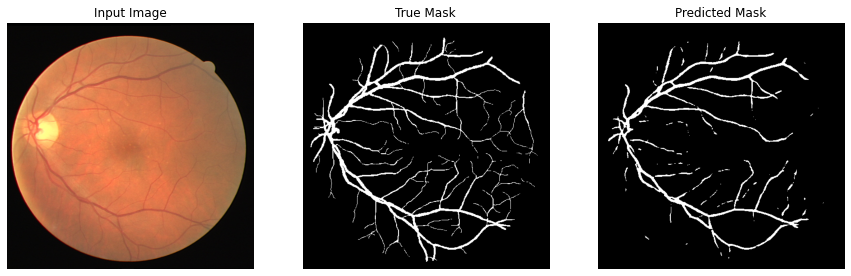


Sample Prediction after epoch 216

Epoch 217/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1050 - accuracy: 0.9782
Epoch 218/400
2/2 [==============================] - 1s 417ms/step - loss: 0.1046 - accuracy: 0.9782
Epoch 219/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1051 - accuracy: 0.9779
Epoch 220/400
2/2 [==============================] - 1s 418ms/step - loss: 0.1037 - accuracy: 0.9784
Epoch 221/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1031 - accuracy: 0.9786


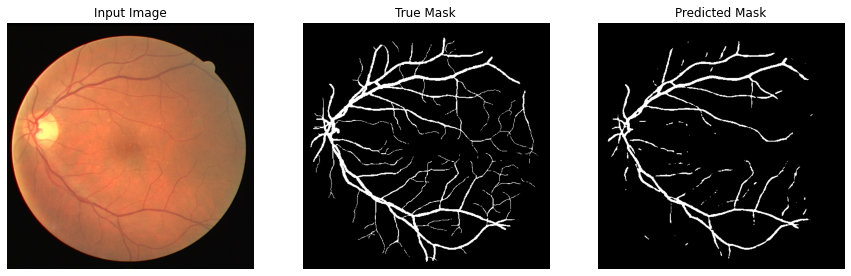


Sample Prediction after epoch 221

Epoch 222/400
2/2 [==============================] - 1s 415ms/step - loss: 0.1034 - accuracy: 0.9782
Epoch 223/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1032 - accuracy: 0.9783
Epoch 224/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1033 - accuracy: 0.9780
Epoch 225/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1019 - accuracy: 0.9787
Epoch 226/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1015 - accuracy: 0.9786


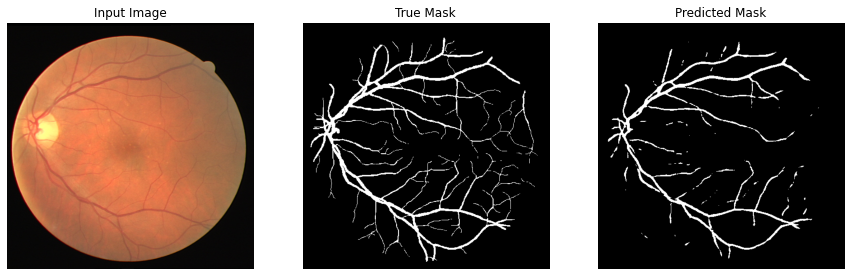


Sample Prediction after epoch 226

Epoch 227/400
2/2 [==============================] - 1s 420ms/step - loss: 0.1012 - accuracy: 0.9787
Epoch 228/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1021 - accuracy: 0.9779
Epoch 229/400
2/2 [==============================] - 1s 416ms/step - loss: 0.1008 - accuracy: 0.9785
Epoch 230/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0999 - accuracy: 0.9790
Epoch 231/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0997 - accuracy: 0.9789


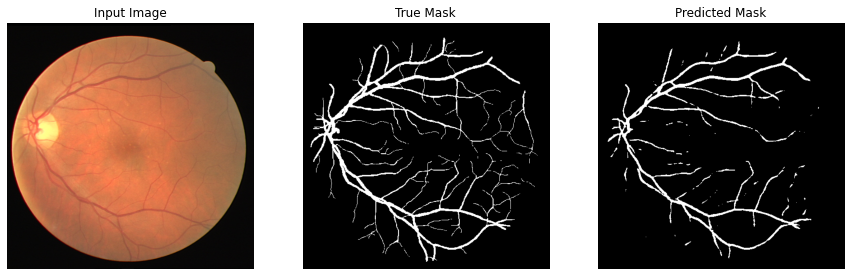


Sample Prediction after epoch 231

Epoch 232/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0991 - accuracy: 0.9791
Epoch 233/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0985 - accuracy: 0.9794
Epoch 234/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0980 - accuracy: 0.9795
Epoch 235/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0983 - accuracy: 0.9792
Epoch 236/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0980 - accuracy: 0.9792


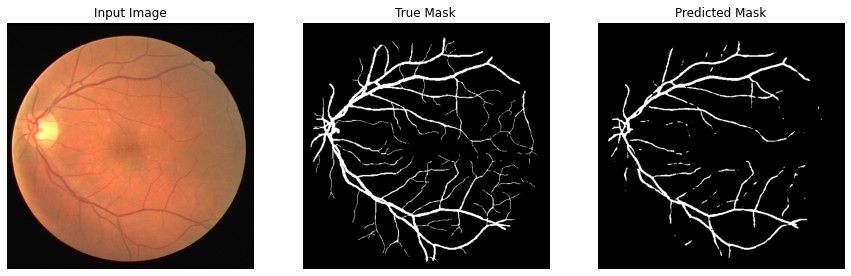


Sample Prediction after epoch 236

Epoch 237/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0971 - accuracy: 0.9796
Epoch 238/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0973 - accuracy: 0.9793
Epoch 239/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0964 - accuracy: 0.9797
Epoch 240/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0963 - accuracy: 0.9796
Epoch 241/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0959 - accuracy: 0.9797


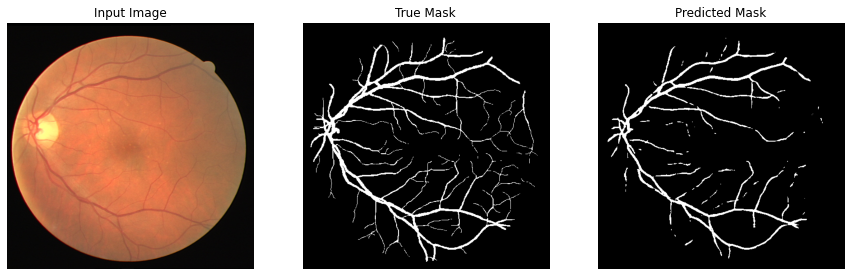


Sample Prediction after epoch 241

Epoch 242/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0955 - accuracy: 0.9798
Epoch 243/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0956 - accuracy: 0.9796
Epoch 244/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0942 - accuracy: 0.9803
Epoch 245/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0944 - accuracy: 0.9800
Epoch 246/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0936 - accuracy: 0.9803


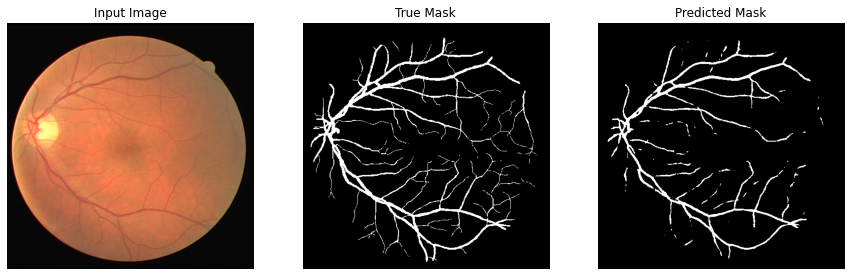


Sample Prediction after epoch 246

Epoch 247/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0936 - accuracy: 0.9802
Epoch 248/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0930 - accuracy: 0.9805
Epoch 249/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0951 - accuracy: 0.9789
Epoch 250/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0926 - accuracy: 0.9803
Epoch 251/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0929 - accuracy: 0.9801


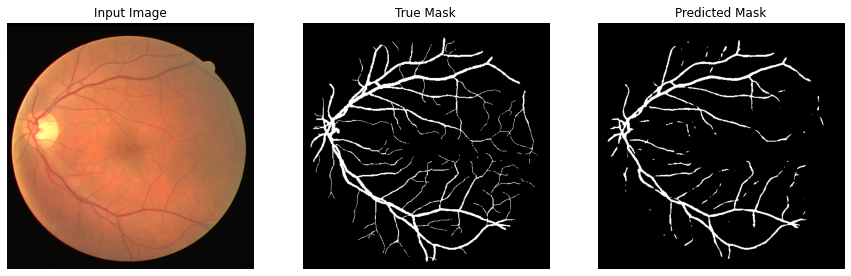


Sample Prediction after epoch 251

Epoch 252/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0924 - accuracy: 0.9800
Epoch 253/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0921 - accuracy: 0.9801
Epoch 254/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0911 - accuracy: 0.9808
Epoch 255/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0906 - accuracy: 0.9809
Epoch 256/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0918 - accuracy: 0.9799


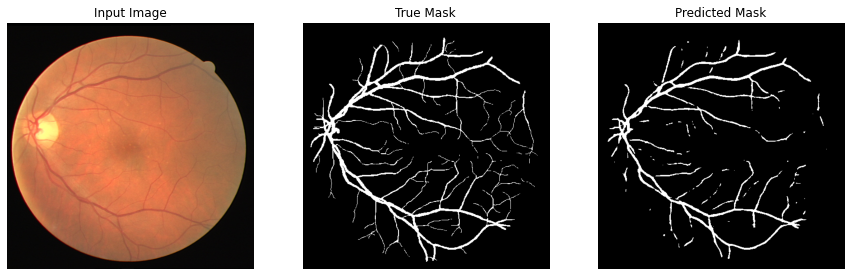


Sample Prediction after epoch 256

Epoch 257/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0905 - accuracy: 0.9806
Epoch 258/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0917 - accuracy: 0.9795
Epoch 259/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0903 - accuracy: 0.9804
Epoch 260/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0898 - accuracy: 0.9806
Epoch 261/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0894 - accuracy: 0.9808


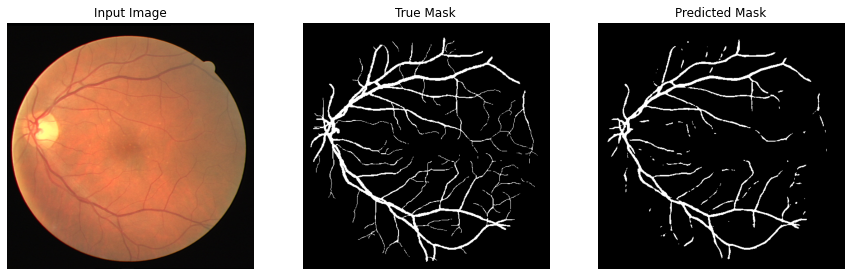


Sample Prediction after epoch 261

Epoch 262/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0891 - accuracy: 0.9807
Epoch 263/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0893 - accuracy: 0.9805
Epoch 264/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0891 - accuracy: 0.9805
Epoch 265/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0879 - accuracy: 0.9811
Epoch 266/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0876 - accuracy: 0.9812


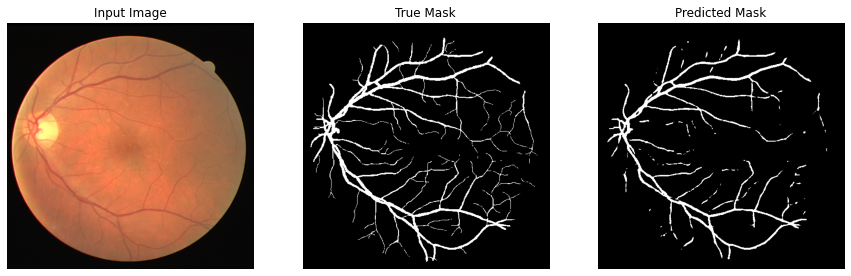


Sample Prediction after epoch 266

Epoch 267/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0875 - accuracy: 0.9811
Epoch 268/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0871 - accuracy: 0.9812
Epoch 269/400
2/2 [==============================] - 1s 405ms/step - loss: 0.0863 - accuracy: 0.9817
Epoch 270/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0863 - accuracy: 0.9815
Epoch 271/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0864 - accuracy: 0.9813


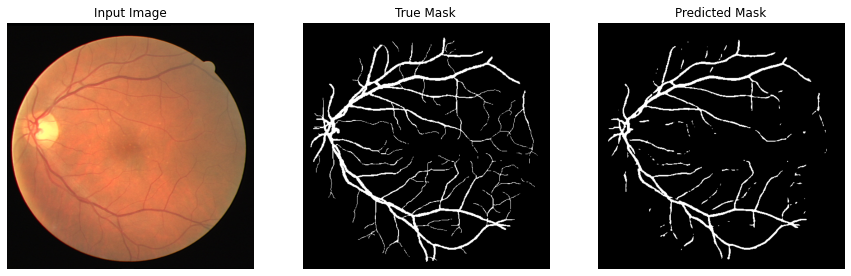


Sample Prediction after epoch 271

Epoch 272/400
2/2 [==============================] - 1s 414ms/step - loss: 0.0863 - accuracy: 0.9813
Epoch 273/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0859 - accuracy: 0.9813
Epoch 274/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0857 - accuracy: 0.9813
Epoch 275/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0850 - accuracy: 0.9817
Epoch 276/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0846 - accuracy: 0.9818


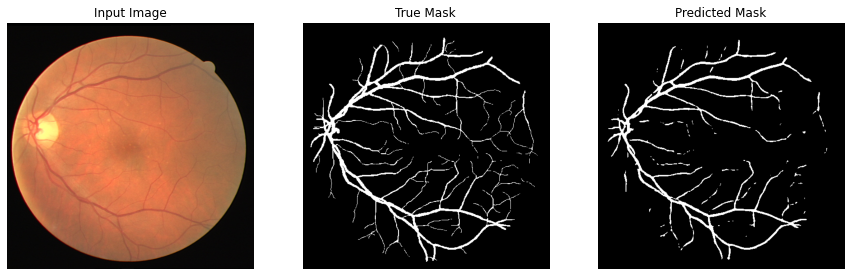


Sample Prediction after epoch 276

Epoch 277/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0847 - accuracy: 0.9816
Epoch 278/400
2/2 [==============================] - 1s 402ms/step - loss: 0.0853 - accuracy: 0.9810
Epoch 279/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0847 - accuracy: 0.9814
Epoch 280/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0839 - accuracy: 0.9816
Epoch 281/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0838 - accuracy: 0.9816


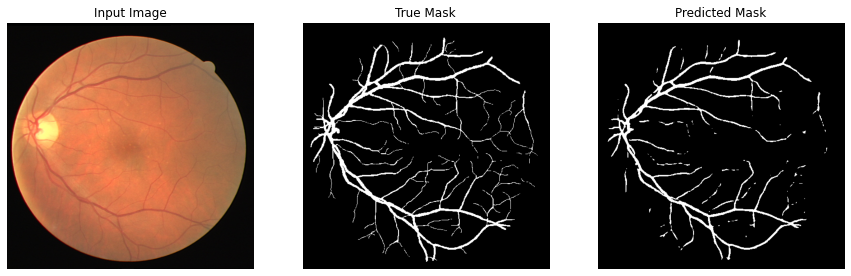


Sample Prediction after epoch 281

Epoch 282/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0833 - accuracy: 0.9818
Epoch 283/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0845 - accuracy: 0.9809
Epoch 284/400
2/2 [==============================] - 1s 405ms/step - loss: 0.0844 - accuracy: 0.9808
Epoch 285/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0826 - accuracy: 0.9818
Epoch 286/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0826 - accuracy: 0.9816


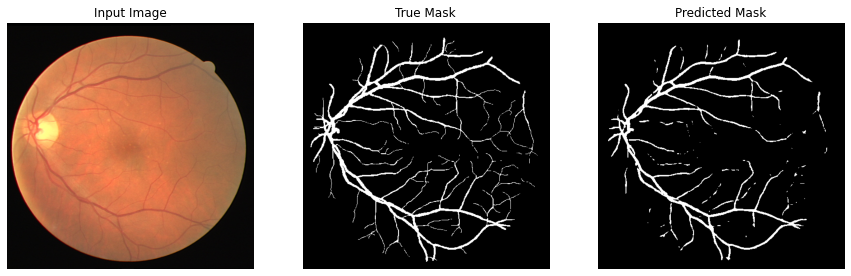


Sample Prediction after epoch 286

Epoch 287/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0822 - accuracy: 0.9819
Epoch 288/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0817 - accuracy: 0.9821
Epoch 289/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0811 - accuracy: 0.9823
Epoch 290/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0814 - accuracy: 0.9821
Epoch 291/400
2/2 [==============================] - 1s 402ms/step - loss: 0.0812 - accuracy: 0.9822


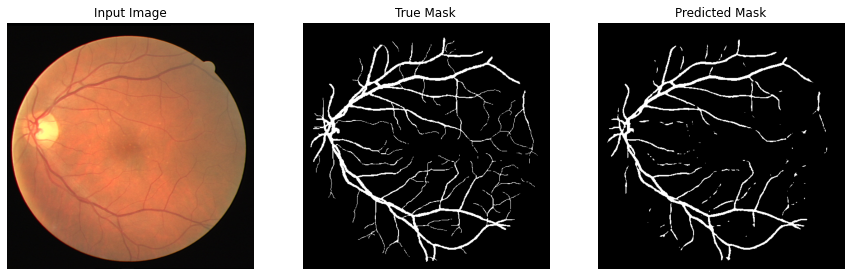


Sample Prediction after epoch 291

Epoch 292/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0807 - accuracy: 0.9823
Epoch 293/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0801 - accuracy: 0.9825
Epoch 294/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0803 - accuracy: 0.9822
Epoch 295/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0801 - accuracy: 0.9822
Epoch 296/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0799 - accuracy: 0.9823


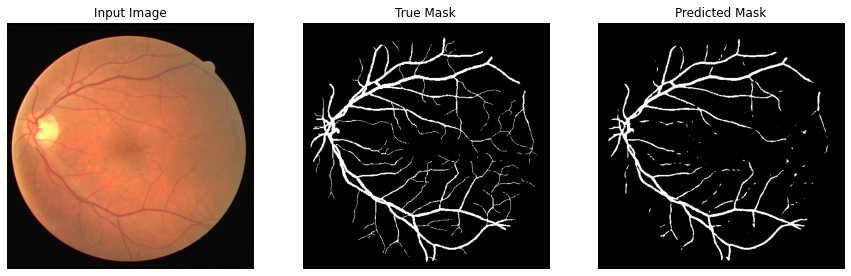


Sample Prediction after epoch 296

Epoch 297/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0802 - accuracy: 0.9820
Epoch 298/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0788 - accuracy: 0.9827
Epoch 299/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0793 - accuracy: 0.9824
Epoch 300/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0784 - accuracy: 0.9827
Epoch 301/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0789 - accuracy: 0.9822


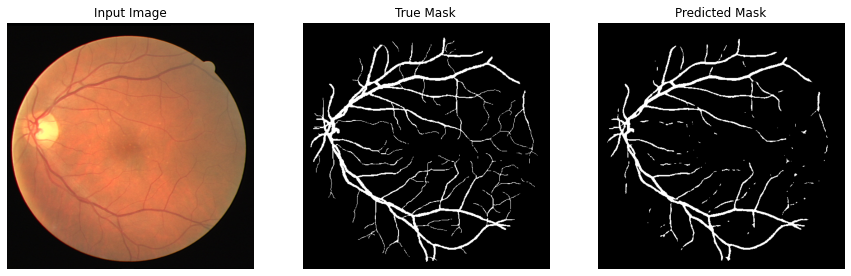


Sample Prediction after epoch 301

Epoch 302/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0780 - accuracy: 0.9830
Epoch 303/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0776 - accuracy: 0.9829
Epoch 304/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0790 - accuracy: 0.9819
Epoch 305/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0770 - accuracy: 0.9831
Epoch 306/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0772 - accuracy: 0.9828


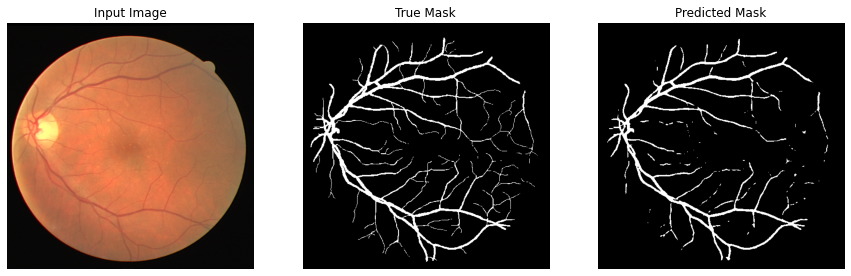


Sample Prediction after epoch 306

Epoch 307/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0767 - accuracy: 0.9830
Epoch 308/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0769 - accuracy: 0.9829
Epoch 309/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0759 - accuracy: 0.9834
Epoch 310/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0759 - accuracy: 0.9832
Epoch 311/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0756 - accuracy: 0.9834


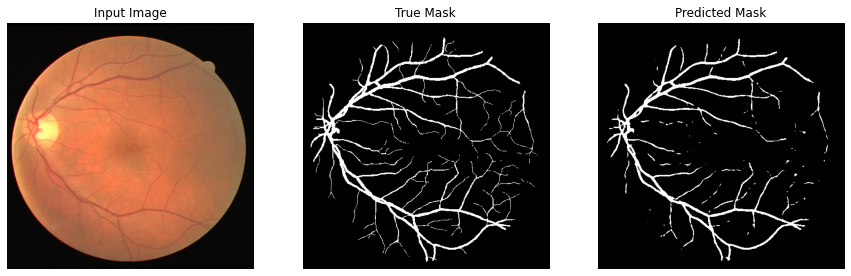


Sample Prediction after epoch 311

Epoch 312/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0763 - accuracy: 0.9828
Epoch 313/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0753 - accuracy: 0.9833
Epoch 314/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0746 - accuracy: 0.9837
Epoch 315/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0756 - accuracy: 0.9828
Epoch 316/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0751 - accuracy: 0.9831


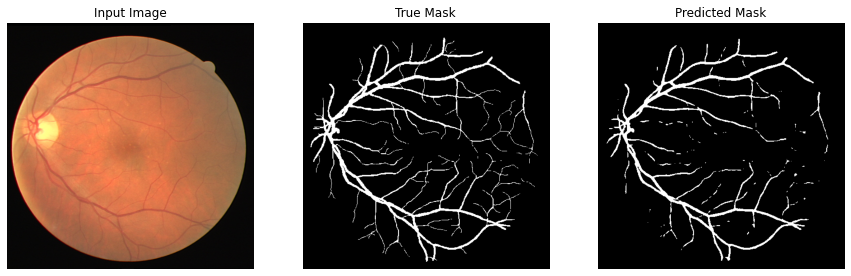


Sample Prediction after epoch 316

Epoch 317/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0741 - accuracy: 0.9837
Epoch 318/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0741 - accuracy: 0.9836
Epoch 319/400
2/2 [==============================] - 1s 402ms/step - loss: 0.0741 - accuracy: 0.9833
Epoch 320/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0739 - accuracy: 0.9835
Epoch 321/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0733 - accuracy: 0.9838


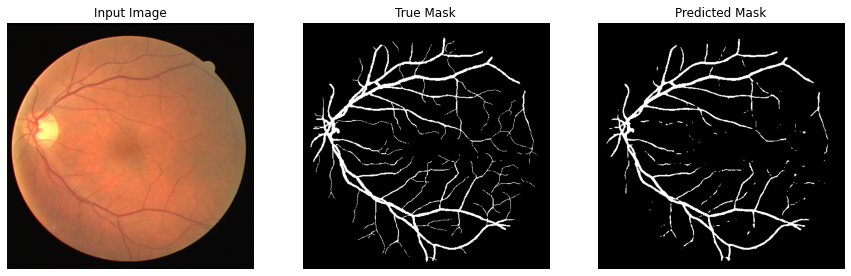


Sample Prediction after epoch 321

Epoch 322/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0733 - accuracy: 0.9837
Epoch 323/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0730 - accuracy: 0.9838
Epoch 324/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0723 - accuracy: 0.9841
Epoch 325/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0732 - accuracy: 0.9833
Epoch 326/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0717 - accuracy: 0.9844


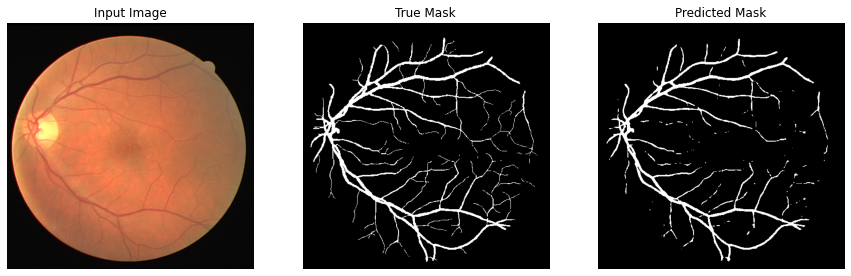


Sample Prediction after epoch 326

Epoch 327/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0721 - accuracy: 0.9839
Epoch 328/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0718 - accuracy: 0.9840
Epoch 329/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0716 - accuracy: 0.9841
Epoch 330/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0712 - accuracy: 0.9842
Epoch 331/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0720 - accuracy: 0.9836


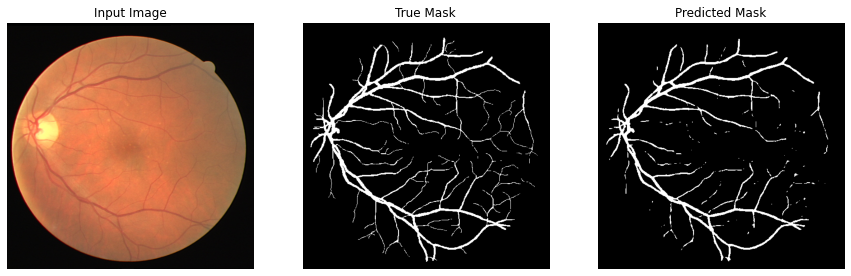


Sample Prediction after epoch 331

Epoch 332/400
2/2 [==============================] - 1s 419ms/step - loss: 0.0710 - accuracy: 0.9842
Epoch 333/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0711 - accuracy: 0.9839
Epoch 334/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0703 - accuracy: 0.9844
Epoch 335/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0701 - accuracy: 0.9844
Epoch 336/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0704 - accuracy: 0.9841


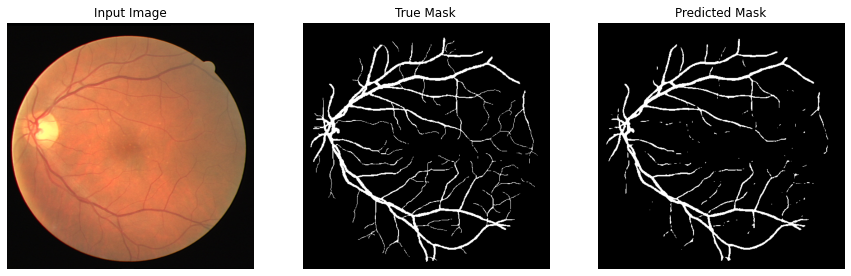


Sample Prediction after epoch 336

Epoch 337/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0695 - accuracy: 0.9847
Epoch 338/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0707 - accuracy: 0.9838
Epoch 339/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0700 - accuracy: 0.9842
Epoch 340/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0697 - accuracy: 0.9841
Epoch 341/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0692 - accuracy: 0.9844


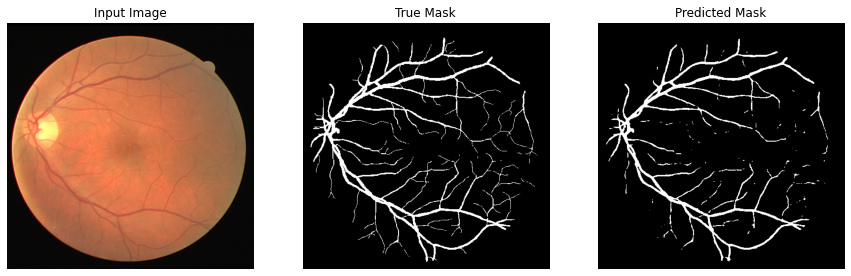


Sample Prediction after epoch 341

Epoch 342/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0691 - accuracy: 0.9844
Epoch 343/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0696 - accuracy: 0.9840
Epoch 344/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0689 - accuracy: 0.9843
Epoch 345/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0681 - accuracy: 0.9847
Epoch 346/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0684 - accuracy: 0.9845


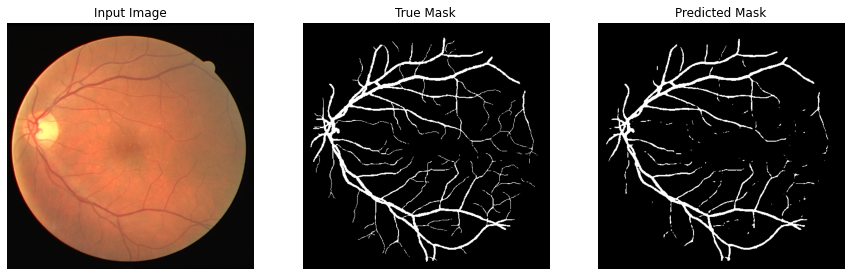


Sample Prediction after epoch 346

Epoch 347/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0684 - accuracy: 0.9843
Epoch 348/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0676 - accuracy: 0.9849
Epoch 349/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0679 - accuracy: 0.9846
Epoch 350/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0685 - accuracy: 0.9841
Epoch 351/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0674 - accuracy: 0.9846


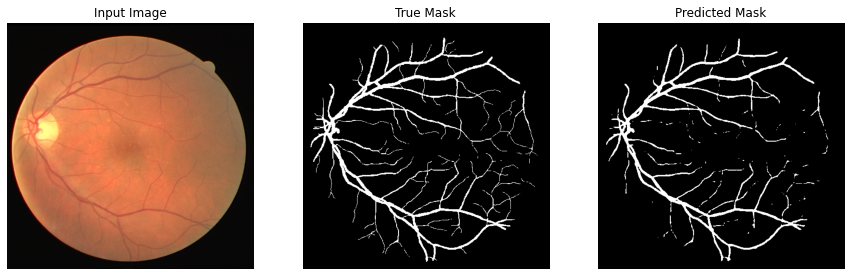


Sample Prediction after epoch 351

Epoch 352/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0669 - accuracy: 0.9849
Epoch 353/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0673 - accuracy: 0.9845
Epoch 354/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0670 - accuracy: 0.9847
Epoch 355/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0666 - accuracy: 0.9848
Epoch 356/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0665 - accuracy: 0.9847


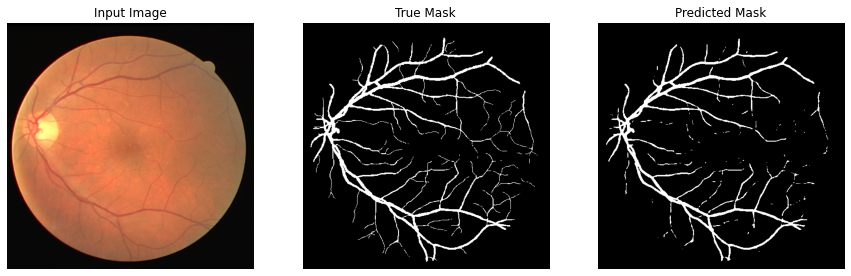


Sample Prediction after epoch 356

Epoch 357/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0662 - accuracy: 0.9850
Epoch 358/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0664 - accuracy: 0.9847
Epoch 359/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0668 - accuracy: 0.9844
Epoch 360/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0655 - accuracy: 0.9852
Epoch 361/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0658 - accuracy: 0.9847


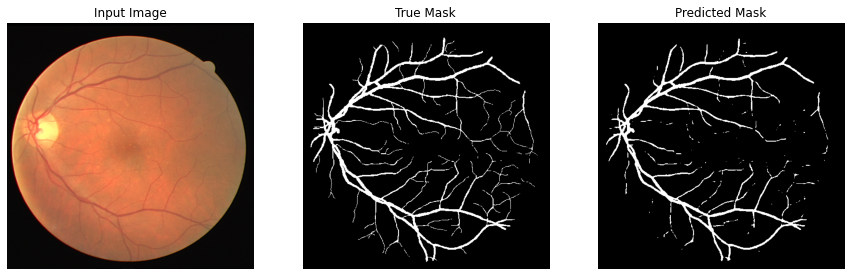


Sample Prediction after epoch 361

Epoch 362/400
2/2 [==============================] - 1s 420ms/step - loss: 0.0654 - accuracy: 0.9850
Epoch 363/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0652 - accuracy: 0.9850
Epoch 364/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0650 - accuracy: 0.9851
Epoch 365/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0646 - accuracy: 0.9853
Epoch 366/400
2/2 [==============================] - 1s 402ms/step - loss: 0.0646 - accuracy: 0.9852


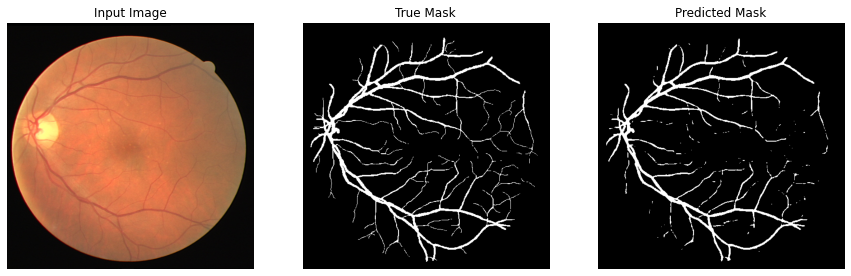


Sample Prediction after epoch 366

Epoch 367/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0645 - accuracy: 0.9852
Epoch 368/400
2/2 [==============================] - 1s 402ms/step - loss: 0.0635 - accuracy: 0.9859
Epoch 369/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0641 - accuracy: 0.9853
Epoch 370/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0642 - accuracy: 0.9853
Epoch 371/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0635 - accuracy: 0.9855


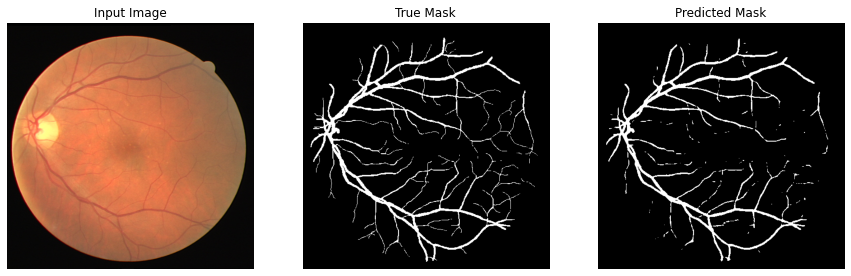


Sample Prediction after epoch 371

Epoch 372/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0634 - accuracy: 0.9856
Epoch 373/400
2/2 [==============================] - 1s 404ms/step - loss: 0.0641 - accuracy: 0.9850
Epoch 374/400
2/2 [==============================] - 1s 421ms/step - loss: 0.0625 - accuracy: 0.9860
Epoch 375/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0626 - accuracy: 0.9859
Epoch 376/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0628 - accuracy: 0.9856


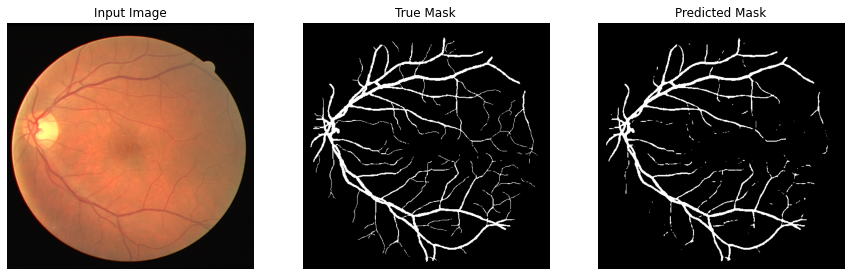


Sample Prediction after epoch 376

Epoch 377/400
2/2 [==============================] - 1s 403ms/step - loss: 0.0618 - accuracy: 0.9862
Epoch 378/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0621 - accuracy: 0.9859
Epoch 379/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0624 - accuracy: 0.9856
Epoch 380/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0620 - accuracy: 0.9859
Epoch 381/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0636 - accuracy: 0.9847


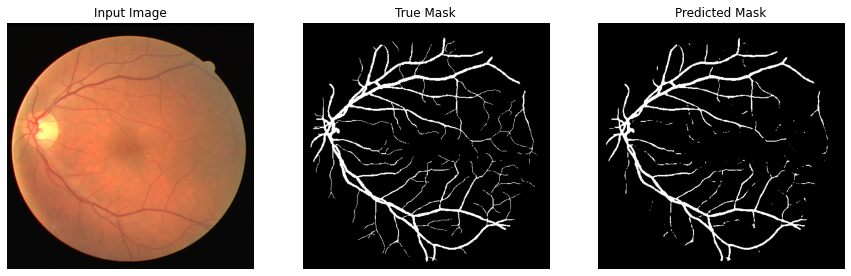


Sample Prediction after epoch 381

Epoch 382/400
2/2 [==============================] - 1s 401ms/step - loss: 0.0616 - accuracy: 0.9860
Epoch 383/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0610 - accuracy: 0.9863
Epoch 384/400
2/2 [==============================] - 1s 405ms/step - loss: 0.0610 - accuracy: 0.9862
Epoch 385/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0607 - accuracy: 0.9864
Epoch 386/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0605 - accuracy: 0.9864


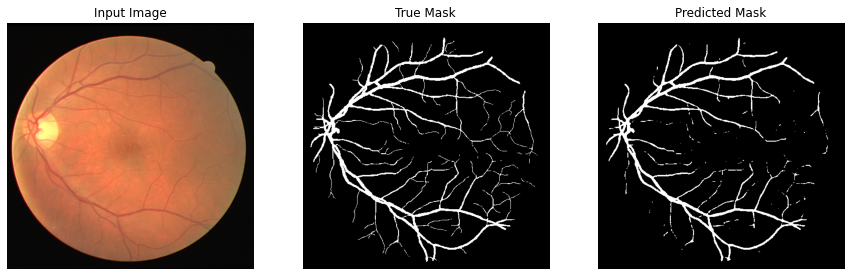


Sample Prediction after epoch 386

Epoch 387/400
2/2 [==============================] - 1s 418ms/step - loss: 0.0605 - accuracy: 0.9864
Epoch 388/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0606 - accuracy: 0.9861
Epoch 389/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0602 - accuracy: 0.9863
Epoch 390/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0607 - accuracy: 0.9859
Epoch 391/400
2/2 [==============================] - 1s 402ms/step - loss: 0.0603 - accuracy: 0.9860


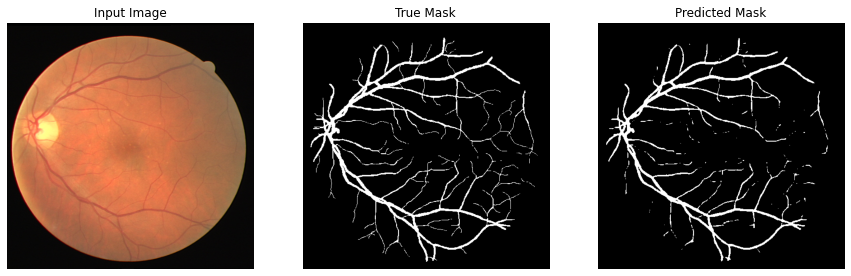


Sample Prediction after epoch 391

Epoch 392/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0600 - accuracy: 0.9863
Epoch 393/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0597 - accuracy: 0.9864
Epoch 394/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0590 - accuracy: 0.9868
Epoch 395/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0591 - accuracy: 0.9867
Epoch 396/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0598 - accuracy: 0.9862


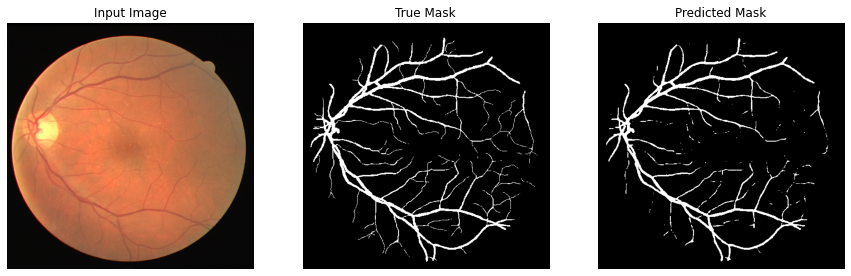


Sample Prediction after epoch 396

Epoch 397/400
2/2 [==============================] - 1s 417ms/step - loss: 0.0593 - accuracy: 0.9863
Epoch 398/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0590 - accuracy: 0.9865
Epoch 399/400
2/2 [==============================] - 1s 415ms/step - loss: 0.0584 - accuracy: 0.9869
Epoch 400/400
2/2 [==============================] - 1s 416ms/step - loss: 0.0585 - accuracy: 0.9867


In [10]:
# define optomizer
optim = keras.optimizers.Adam(0.0001)
bce   = keras.losses.BinaryCrossentropy()
metrics = ["accuracy"]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, bce, metrics)

model.fit(
    train_dataset, 
    callbacks=[DisplayCallback(train_dataset)],
    epochs=400
)